In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/Registro de Nubes')
!pwd

Mounted at /content/drive
/content/drive/.shortcut-targets-by-id/1bUVmxKZXlCNnu4CbA53Po31b084HWCvL/Registro de Nubes


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
def read_pc_by_class(num_point_Clouds, num_points, clase, inicial_path):

  lista = []
  path_i = inicial_path + '/' + clase + '/' + clase +'_'
  
  for i in range(1, num_point_Clouds+1):
    if(i<10):
      path = path_i + '00' + str(0)+str(i) + '.txt'
    if(i>=10 and i<100):
      path = path_i + '00' + str(i) + '.txt'
    if(i>=100 and i<1000):
      path = path_i + '0' + str(i) + '.txt'
    if(i>=1000):
      path = path_i + str(i) + '.txt'
    pC = np.loadtxt(path, delimiter=',', usecols=(0,1,2))
    pC = pC[:num_points, :]
    lista.append(pC)



  return lista

In [ ]:
os.chdir('/content/drive/MyDrive/PROYECTO DE GRADO/Code/DPDist-master/log/test1__imp_type_1enc_3dmfvEmbS512BN0LR0001wd0sigma125K5AUG1lsl1_distnoise0chairov1np64')
!pwd

/content/drive/.shortcut-targets-by-id/1asBEAN-S2b77S-W1swprmpEcUXwsqzS3/PROYECTO DE GRADO/Code/DPDist-master/log/test1__imp_type_1enc_3dmfvEmbS512BN0LR0001wd0sigma125K5AUG1lsl1_distnoise0chairov1np64


In [ ]:
chair = read_pc_by_class(2, 4000, 'chair', '../../data/modelnet40_normal_resampled')

In [ ]:
import math
from functools import reduce
import numpy as np
def rotacionZYX(radz, rady, radx):
  Ms = []
  z= radz
  y= rady
  x= radx

  cosz = math.cos(z)
  sinz = math.sin(z)
  Ms.append(np.array(
          [[cosz, -sinz, 0],
            [sinz, cosz, 0],
            [0, 0, 1]]))

  cosy = math.cos(y)
  siny = math.sin(y)
  Ms.append(np.array(
          [[cosy, 0, siny],
            [0, 1, 0],
            [-siny, 0, cosy]]))

  cosx = math.cos(x)
  sinx = math.sin(x)
  Ms.append(np.array(
          [[1, 0, 0],
            [0, cosx, -sinx],
            [0, sinx, cosx]]))


  Mzxy = reduce(np.dot, Ms[::-1])
  return Mzxy

In [ ]:
point_cloud_A = chair[0]
Rm = rotacionZYX(np.pi/2, np.pi/3, np.pi/4)
point_cloud_B= np.dot(Rm, chair[0].T).T


In [ ]:
Rm

array([[ 3.06161700e-17, -5.00000000e-01,  8.66025404e-01],
       [ 7.07106781e-01, -6.12372436e-01, -3.53553391e-01],
       [ 7.07106781e-01,  6.12372436e-01,  3.53553391e-01]])

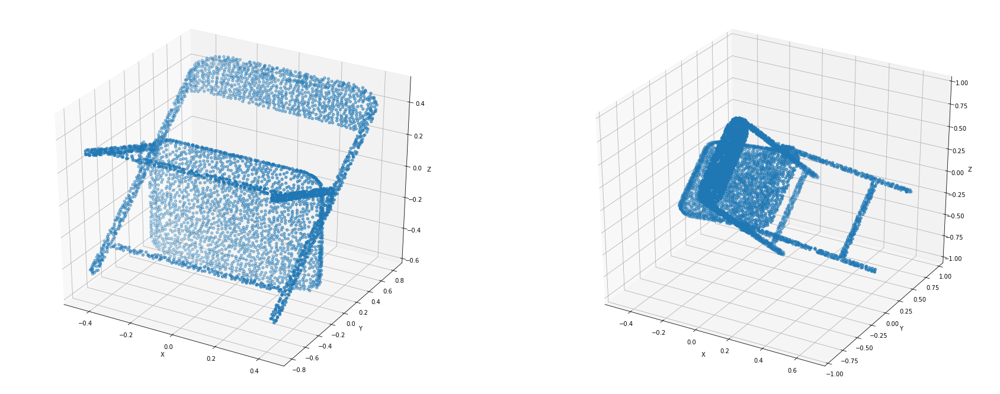

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = point_cloud_A[:,0]
Y = point_cloud_A [:,1]
Z = point_cloud_A[:,2]
ax.scatter3D(X, Y, Z)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = point_cloud_B[:,0]
Y = point_cloud_B[:,1]
Z = point_cloud_B[:,2]
ax.scatter3D(X, Y, Z)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

## Pruebas Descomposición SVD

In [ ]:
m = point_cloud_A.shape[1] #m numero de dimensiones
    
#obtiene los centroides de cada nube de puntos basado en la media de los puntos
centroid_A = np.mean(point_cloud_A, axis=0)
centroid_B = np.mean(point_cloud_B, axis=0)

#Centrando las nubes de puntos a cero (restando su centroide)
cA = point_cloud_A - centroid_A
cB = point_cloud_B - centroid_B

In [ ]:
cA.shape

(4000, 3)

In [ ]:
cB.shape

(4000, 3)

In [ ]:
H = np.dot(cA.T, cB) #plano H
U, S, Vt = np.linalg.svd(H) #cualquier transformación puede considerarse como una secuencia de rotación (V * ), escala (S) y rotación de nuevo (U)
R = np.dot(Vt.T, U.T) #matriz de rotación

In [ ]:
H

array([[-2.72726677e-01,  2.56953038e+02,  2.55336005e+02],
       [-1.02884365e+02, -4.95570938e+02,  4.94363393e+02],
       [ 1.88303642e+02, -2.90465102e+02,  2.89322566e+02]])

In [ ]:
U

array([[ 2.55164050e-03,  9.99995160e-01,  1.78009358e-03],
       [-8.61758552e-01,  3.10197079e-03, -5.07309152e-01],
       [-5.07312219e-01, -2.39540285e-04,  8.61762296e-01]])

In [ ]:
S

array([811.24007715, 362.24060111, 214.47469141])

In [ ]:
Vt

array([[-0.00846599,  0.70888342, -0.70527486],
       [-0.00175843,  0.70528849,  0.70891823],
       [ 0.99996262,  0.00724188, -0.00472444]])

In [ ]:
s = np.zeros((3,3))
np.fill_diagonal(s, S)

In [ ]:
s

array([[811.24007715,   0.        ,   0.        ],
       [  0.        , 362.24060111,   0.        ],
       [  0.        ,   0.        , 214.47469141]])

In [ ]:
np.dot(np.dot(U, s), Vt)

array([[-2.72726677e-01,  2.56953038e+02,  2.55336005e+02],
       [-1.02884365e+02, -4.95570938e+02,  4.94363393e+02],
       [ 1.88303642e+02, -2.90465102e+02,  2.89322566e+02]])

In [ ]:
H

array([[-2.72726677e-01,  2.56953038e+02,  2.55336005e+02],
       [-1.02884365e+02, -4.95570938e+02,  4.94363393e+02],
       [ 1.88303642e+02, -2.90465102e+02,  2.89322566e+02]])

In [ ]:
R = np.dot(Vt.T, U.T)

In [ ]:
R

array([[ 1.44840018e-16, -5.00000000e-01,  8.66025404e-01],
       [ 7.07106781e-01, -6.12372436e-01, -3.53553391e-01],
       [ 7.07106781e-01,  6.12372436e-01,  3.53553391e-01]])

In [ ]:
new = np.dot(R, cA.T).T

## ICP nuevo

In [ ]:
def nearest_neighbor(src, dst):
    from sklearn.neighbors import NearestNeighbors
    #Encuentra el vecino más cercano mediante el método euclidiano
    #src Matriz de puntos origen
    #dst Matriz de puntos destino
    #Retorna las distancias euclidianas del vecino más cercano y sus indices

    if (src.shape == dst.shape): #Verifica que las nubes de puntos tengan la misma dimensión
      
      neigh = NearestNeighbors(n_neighbors=1) #Busca un vecino 
      neigh.fit(dst) #Ajusta el estimador de vecinos más cercanos del conjunto de datos de entrenamiento
      distances, indices = neigh.kneighbors(src, return_distance=True) #Encuentra los K-vecinos de un punto
    
    else:
      print('Las dimensiones de las nubes de puntos no corresponden o son diferentes' )

    
    return distances.ravel(), indices.ravel()

In [ ]:
def ICP_juanrtato(point_cloud_A, point_cloud_B, num_iterations, tolerance): #source, destino
  if (point_cloud_A.shape == point_cloud_B.shape):
    Tr_list = [] #Lista de matrices de rotacion
    T_list = [] #Lista de matrices de transformacion
    n = point_cloud_A.shape[1] #n numero de dimensiones
    source = point_cloud_A #origen
    destinity = point_cloud_B #destino
    prev_error = 0
    for i in range(num_iterations):


      
      #centroides de cada nube de puntos basado en la media
      centroid_A = np.mean(source, axis=0)
      centroid_B = np.mean(destinity, axis=0)
      
      #Centrando las nubes de puntos a cero (restando su centroide)
      cA = source - centroid_A #nubeA centrada
      cB = destinity - centroid_B #nubeB centrada

      distances, indices = nearest_neighbor(source, destinity) # calcula los vecinos mas cercanos y sus distancias

      H = np.dot(cA.T, cB[indices, :]) #matriz de covarianza cruzada
      
      U, S, Vt = np.linalg.svd(H) #descomposición SVD (U: MatrizVectSingularesIzq, S: Valores Singulares, Vt:MatrizVectSingularesIzqTranspuesta)

      # Rotacion
      R = np.dot(Vt.T, U.T) #matriz de rotación

      if np.linalg.det(R) < 0:
       Vt[m-1,:] *= -1
       R = np.dot(Vt.T, U.T)
       
      # Traslacion
      t = centroid_B.T - np.dot(R,centroid_A.T) #resta al centroide de B el centroide rotado de A
      Tr_list.append(R) #Almacena la matriz de rotacion en la lista
      source = np.dot(R, source.T).T + t #Transforma la nube source 
      
      T = np.identity(3+1) #Matriz de transformación T
      T[:n, :n] = R #Agrega la matriz de rotaciones a la matriz T
      T[:n, n] = t #Agrega el vector de traslacioness a la matriz T
      
      T_list.append(T)

      '''
      #error
      mean_error = np.mean(distances)
      print(mean_error)
      if np.abs(prev_error - mean_error) < tolerance:
          break
      prev_error = mean_error
      '''
    T_list = np.array(T_list)
    T_Final =reduce(np.dot, T_list[:, :4, :4])
    return  T_Final



### Pruebas ICP nuevo

In [ ]:
point_cloud_A = chair[0][0:1024]
Rm = rotacionZYX(np.pi/2, np.pi/3, np.pi/4) 
t = 1
point_cloud_B= np.dot(Rm, chair[0][1024:1024*2].T).T + t

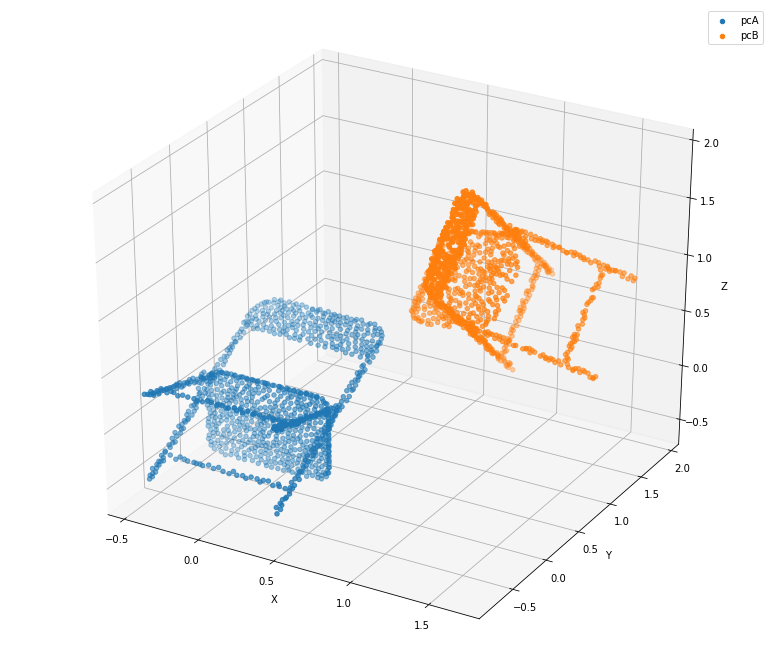

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')

X = point_cloud_A[:,0]
Y = point_cloud_A[:,1]
Z = point_cloud_A[:,2]
ax.scatter3D(X, Y, Z)


X = point_cloud_B[:,0]
Y = point_cloud_B[:,1]
Z = point_cloud_B[:,2]
ax.scatter3D(X, Y, Z)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.legend(['pcA','pcB'])
plt.show()

In [ ]:
Tr = ICP_juanrtato(point_cloud_A, point_cloud_B, 10, 0.0001)

In [ ]:
Tr

array([[ 0.9036362 ,  0.01362926, -0.42808394,  1.0931286 ],
       [ 0.1885606 ,  0.88475962,  0.42619867,  0.8271742 ],
       [ 0.38456016, -0.46584831,  0.79693088,  1.1144441 ],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [ ]:
reg = np.dot(Tr[:3, :3],point_cloud_A.T).T + Tr[:3, 3]

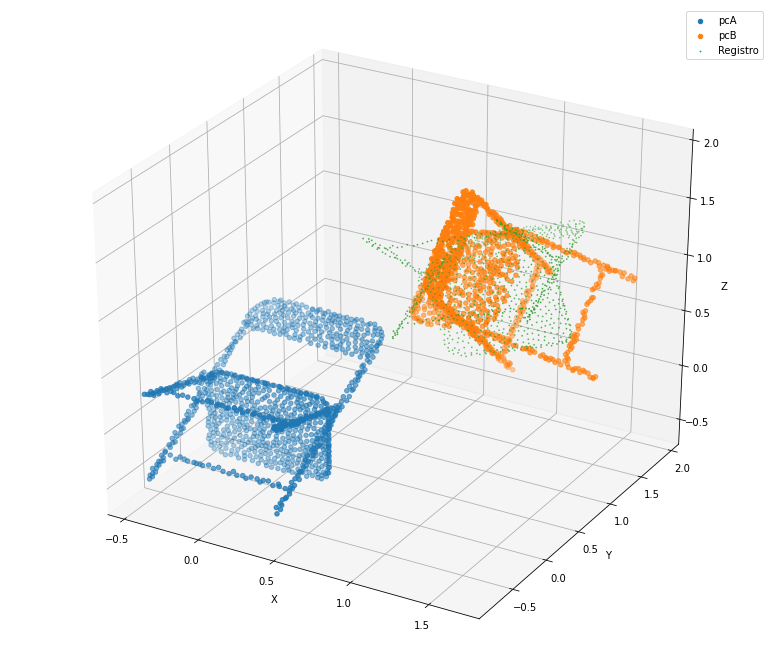

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')

X = point_cloud_A[:,0]
Y = point_cloud_A[:,1]
Z = point_cloud_A[:,2]
ax.scatter3D(X, Y, Z)


X = point_cloud_B[:,0]
Y = point_cloud_B[:,1]
Z = point_cloud_B[:,2]
ax.scatter3D(X, Y, Z)

X = reg[:,0]
Y = reg[:,1]
Z = reg[:,2]
ax.scatter3D(X, Y, Z, s=0.6)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')

ax.legend(['pcA','pcB', 'Registro'])
plt.show()

### DPDist

In [ ]:
point_cloud_A = chair[0][0:512]
Rm = rotacionZYX(np.pi/2, np.pi/3, np.pi/4) 
t = 1
point_cloud_B= np.dot(Rm, chair[0][512:512*2].T).T + t

In [ ]:
import os
import tensorflow.compat.v1 as tf
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
os.chdir('/content/drive/MyDrive/PROYECTO DE GRADO/Code/DPDist-master/log/test1__imp_type_1enc_3dmfvEmbS512BN0LR0001wd0sigma125K5AUG1lsl1_distnoise0chairov1np64')

In [ ]:
def get_bn_decay(batch):
  bn_momentum = tf.train.exponential_decay(
                                            0.5,
                                            batch,#*BATCH_SIZE,
                                            float(0.5),
                                            0.5,
                                            staircase=True)

In [ ]:
def initialize_uninitialized_vars(sess):
    from itertools import compress
    global_vars = tf.global_variables()
    is_not_initialized = sess.run([~(tf.is_variable_initialized(var)) \
                                   for var in global_vars])
    not_initialized_vars = list(compress(global_vars, is_not_initialized))

    if len(not_initialized_vars):
        print('init not_initialized')
        print(not_initialized_vars)
        sess.run(tf.variables_initializer(not_initialized_vars))

In [ ]:
def DPDIST(nubeA, nubeB):
  import tensorflow.compat.v1 as tf
  input_1 = nubeA.reshape(16, 64, nubeA.shape[1])
  input_2 = nubeB.reshape(16,  64 ,nubeB.shape[1])
  noise = np.zeros((16, 64, 3))
  from tensorflow.python.framework import meta_graph
  graph = tf.Graph()
  with graph.as_default():
    with tf.device('/gpu:' + str(0)):
        batch = tf.get_variable('batch', [], initializer=tf.constant_initializer(0), trainable=False)
        #bn_decay = get_bn_decay(batch)
        #tf.summary.scalar('bn_decay', bn_decay) 
        is_training_pl_1 = tf.placeholder(tf.bool, shape=())
        is_training_pl_2 = tf.placeholder(tf.bool, shape=())
        x1 = tf.placeholder(tf.float32, (16, 64,3), name='input1')
        x2 = tf.placeholder(tf.float32, (16, 64,3), name='input2')
        x3 = tf.placeholder(tf.float32, (16, 64,3), name='input3')
        saver31 = tf.train.import_meta_graph('./model.ckpt.meta',
                                            import_scope='g1',
                                            input_map={'input1': x1,
                                                      'input2': x2,
                                                      'Placeholder': is_training_pl_1,
                                                      'add_noise':x3}
                                            )
        labels12 = graph.get_tensor_by_name('g1/labels12:0')
        pred_AB3 = (graph.get_tensor_by_name('g1/pc_compare/output1:0'))
        pred_BA3 = (graph.get_tensor_by_name('g1/pc_compare/output2:0'))
        loss_p = (tf.reduce_mean(pred_AB3[:,:,:,0]) + tf.reduce_mean(pred_BA3[:,:,:,0]))/2.0
    # Create a session
    init = tf.global_variables_initializer()
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    config.allow_soft_placement = True
    config.log_device_placement = False
    sess3 = tf.InteractiveSession(config=config)
    sess3.run(init)
    #DPDist weights loader
    MODEL_PATH = './model.ckpt'
    saver31.restore(sess3, MODEL_PATH)
    initialize_uninitialized_vars(sess3)
    #print('model restored')
    ops3 = {'x1':x1,
            'x2':x2,
            'add_noise':x3,
            # 'pc_Crec':pc_Crec,
            'is_training_pl1':is_training_pl_1,
            'loss':loss_p,
            'labels12':labels12,
            'pred': {'pred_AB':pred_AB3,'pred_BA':pred_BA3}}

    feed_dict={ops3['x1']:input_1,
              ops3['x2']: input_2,
              ops3['is_training_pl1']:False,
              ops3['add_noise']:noise,
              # train_opt_pred3:True,
              }        
    result =sess3.run([ops3['pred']], feed_dict=feed_dict)
    '''
    resultBA=sess3.run(pred_BA3, feed_dict=feed_dict_testing)
    resultAB_0 = resultAB[:,:,:,:]
    resultBA_0 = resultBA[:,:,:,:]  
    resultAB_0 = resultAB_0.reshape(1024,3)
    resultBA_0 = resultAB_0.reshape(1024,3)
    '''
    sess3.close()
    result = np.array(result)
    DistAB = result[0]['pred_AB']
    vDistAB = DistAB.reshape(1024,3)
    DistBA = result[0]['pred_BA']
    vDistBA = DistBA.reshape(1024,3)
  return DistAB,DistBA  #vectores de distanciaAB, #vectores de distanciaBA

In [ ]:
def DPDISTnormaAndDistPc_Pc(vectorDistAB, vectorDistBA):
  
  DPDistanceABmap = []
  for i in range(len(vectorDistAB)):
    DPDistanceAB = np.linalg.norm(vectorDistAB[i])
    DPDistanceABmap.append(DPDistanceAB)
  
  DPDistanceABmap = np.array(DPDistanceABmap)
  
  DPDistanceBAmap = []
  for i in range(len(vectorDistBA)):
    DPDistanceBA= np.linalg.norm(vectorDistBA[i])
    DPDistanceBAmap.append(DPDistanceBA)
  
  DPDistanceBAmap = np.array(DPDistanceBAmap)
  #dist_pcA_pcB=((1/SA.shape[0])*np.sum(DPDistanceABmap))+((1/SB.shape[0])*np.sum(DPDistanceBAmap))
  dist_pcA_pcB2=((1/1024)*np.sum(vectorDistAB))+((1/1024)*np.sum(vectorDistAB))
  return DPDistanceABmap, DPDistanceBAmap, round(dist_pcA_pcB2, 4) #normaVectoresAB, #normaVectoresBA, #distancia de nube a nube 

In [ ]:
def plottear_DPDist(Dist, pc):
  from matplotlib import pyplot as plt
  from mpl_toolkits.mplot3d import Axes3D

  fig = plt.figure(figsize=(40,15))
  ax = fig.add_subplot(1, 3, 3, projection='3d')

  c = Dist.reshape(len(pc))
  c= c[0:]
  color_map = plt.get_cmap('jet')
  scatter_plot = ax.scatter3D(pc[0:,0], pc[0:,1], pc[0:,2], vmax =1, s=100, c=c, cmap = color_map)
  #scatter_plot2 = ax.scatter3D(pcA1024[:,0], pcA1024[:,1], pcA1024[:,2], c='blue', s=100, cmap = color_map)
  plt.colorbar(scatter_plot)
  
  # Show plot

  plt.show()


In [ ]:
def plottearNubes(nubeA, nubeB, title):
  fig = plt.figure(figsize=(30,12))
  ax = fig.add_subplot(1, 2, 1, projection='3d')

  X = nubeA[:,0]
  Y = nubeA[:,1]
  Z = nubeA[:,2]
  ax.scatter3D(X, Y, Z)


  X = nubeB[:,0]
  Y = nubeB[:,1]
  Z = nubeB[:,2]
  ax.scatter3D(X, Y, Z)


 # ax.title(str(title))
  ax.legend(['nubeA','nubeB'])
  plt.show()

In [ ]:
def ord_by_menores_distancias(dist, PC):
  import pandas as pd
  import numpy as np
  lst0 = dist
  lst1 = PC[:,0]
  lst2 = PC[:,1]
  lst3 = PC[:,2]
  df = pd.DataFrame(list(zip(lst0, PC)), columns = ['Dist','xyz'])#.set_index('Dist')
  df = df.sort_values(by=['Dist'])
  #pcOr = np.array([df['x'], df['y'], df['z']])
  #pcOr = pcOr.reshape(1024,3)
  distOrd = np.array(df[0:])[:,0]
  pcOr = np.array(df[0:])[:,1]

  pcOrd = []
  for i in range(len(pcOr)):
    pcOrd.append(pcOr[i][:])
  return distOrd, pcOrd

In [ ]:
def plottear_DPDist_cercanos(Dist, pC, umbral):
  from matplotlib import pyplot as plt
  from mpl_toolkits.mplot3d import Axes3D

  fig = plt.figure(figsize=(40,15))
  ax = fig.add_subplot(1, 3, 3, projection='3d')

  c = Dist.reshape(pC.shape[0])
  c= c[0:]
  C = []
  PC = []
  for i in range(len(c)):
    r = umbral
    if(c[i]<=r):
      C.append(c[i])
      PC.append(pC[i])
  C=np.array(C)
  PC=np.array(PC)
  color_map = plt.get_cmap('jet')
  scatter_plot = ax.scatter3D(PC[0:,0], PC[0:,1], PC[0:,2], s=100, c=C, vmax=1,  cmap = color_map)
  #scatter_plot2 = ax.scatter3D(pcA1024[:,0], pcA1024[:,1], pcA1024[:,2], c='blue', s=100, cmap = color_map)
  plt.colorbar(scatter_plot)
  
  # Show plot

  plt.show()
  print('Cantidad de puntos: ', len(PC))
  return PC
  

In [ ]:
def algoritmoNuestro(point_cloud_A, point_cloud_B, numIter):
  for i in range(numIter):
    
    pcAc = point_cloud_A-np.mean(point_cloud_A)
    pcBc = point_cloud_B-np.mean(point_cloud_B)
    plottearNubes(pcAc, pcBc, 'Nubes Centradas')

    vectDistAB, vectDistBA = DPDIST(pcAc, pcBc)
    vectDistBA = vectDistBA.reshape(len(point_cloud_A),3)
    vectDistAB =vectDistAB.reshape(len(point_cloud_A),3)  
    normAB, normBA, DistPC_PC = DPDISTnormaAndDistPc_Pc(vectDistAB, vectDistBA)
    #normAB = normAB.reshape(1024,3)
    #normBA = normBA.reshape(1024,3)
    #distAB = normAB[:,0]+normAB[:,1]
    #distBA = normBA[:,0]+normBA[:,1]

    distAB = normAB
    distBA = normBA


    DistABord, pcAcOrd = ord_by_menores_distancias(vectDistBA[:,0], pcAc)
    DistBAord, pcBcOrd = ord_by_menores_distancias(vectDistBA[:,0], pcBc)
    pcAcOrd = np.array(pcAcOrd)
    pcBcOrd = np.array(pcBcOrd)

   
    plottearNubes(pcAcOrd, pcBcOrd, 'Nubes Ordenadas')

    plottear_DPDist(DistABord, pcBcOrd)
    plottear_DPDist(DistBAord, pcAcOrd)
    
    puntosAB = plottear_DPDist_cercanos(DistABord, pcBcOrd, 0.5)
    puntosBA = plottear_DPDist_cercanos(DistBAord, pcAcOrd, 0.5)

    if(len(puntosAB)<len(puntosBA)):
      puntosBA = puntosBA[0:len(puntosAB), :]
    else:
      if(len(puntosAB)>len(puntosBA)):
        puntosAB = puntosAB[0:len(puntosBA), :]
    #print(puntosBA.shape, puntosBA.shape)

    
    


    Tr = ICP_juanrtato(puntosBA, puntosAB+1, 10, 0.0001)
    #Tr = ICP_juanrtato(pcAcOrd, pcBcOrd+1, 10, 0.0001)
    reg = np.dot(Tr[:3, :3],pcAcOrd.T).T + Tr[:3, 3]
    print('ITERACION N° ', i)
    fig = plt.figure(figsize=(30,12))
    ax = fig.add_subplot(1, 2, 1, projection='3d')

    X = pcAcOrd[:,0]
    Y = pcAcOrd[:,1]
    Z = pcAcOrd[:,2]
    ax.scatter3D(X, Y, Z)
    X = pcAcOrd[0,0]
    Y = pcAcOrd[0,1]
    Z = pcAcOrd[0,2]
    ax.scatter3D(X, Y, Z, s=100, c='r')


    X = pcBcOrd[:,0]+1
    Y = pcBcOrd[:,1]+1
    Z = pcBcOrd[:,2]+1
    ax.scatter3D(X, Y, Z)
    X = pcBcOrd[0,0]+1
    Y = pcBcOrd[0,1]+1
    Z = pcBcOrd[0,2]+1
    ax.scatter3D(X, Y, Z, s=50, c='b')

    X = reg[:,0]
    Y = reg[:,1]
    Z = reg[:,2]
    ax.scatter3D(X, Y, Z, s=0.6)
    X = reg[0,0]
    Y = reg[0,1]
    Z = reg[0,2]
    ax.scatter3D(X, Y, Z, s=50, c='g')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

    ax.legend(['pcA','P0 pcA', 'pcB','P0 pcB','REG','P0 REG'])
    plt.show()

    
    point_cloud_A = reg
    point_cloud_B = point_cloud_B


##### Prueba ordenar nubes by norm

#### Prueba Algoritmo

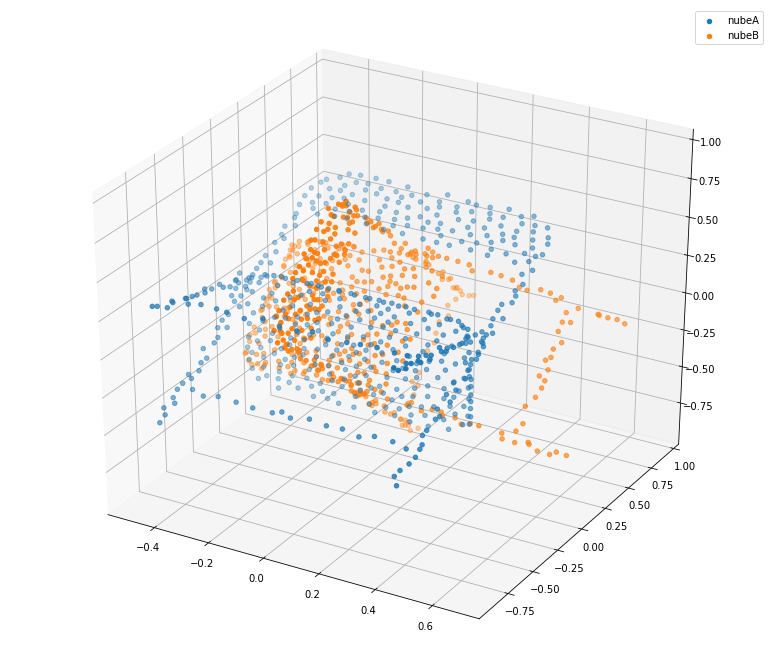

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


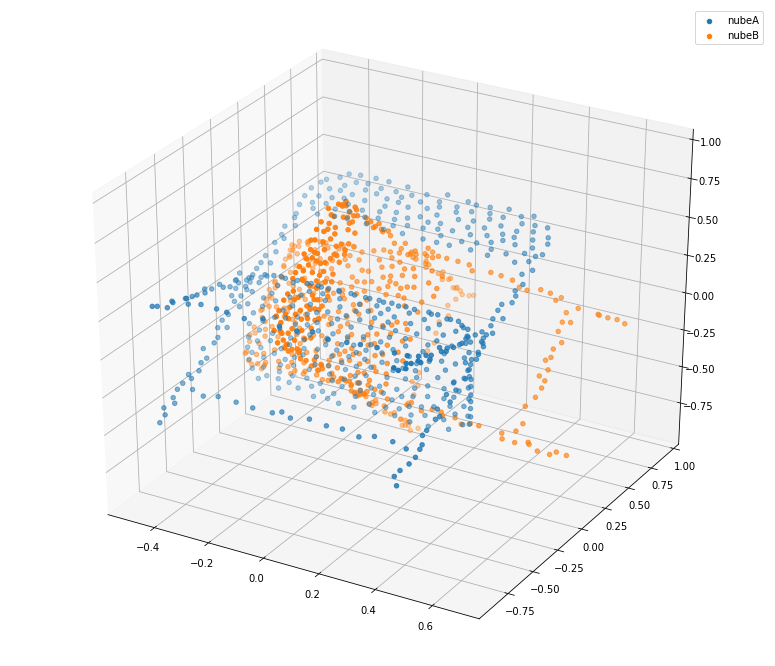

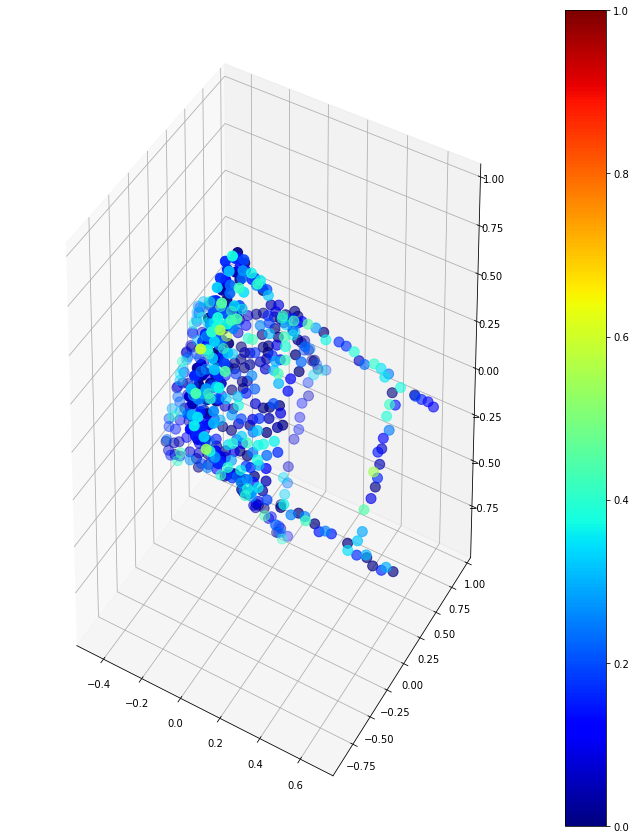

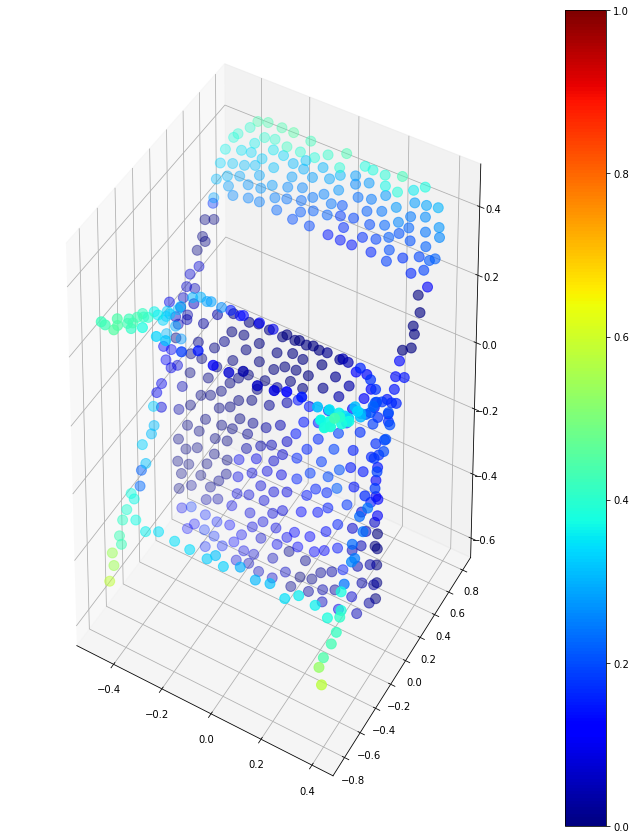

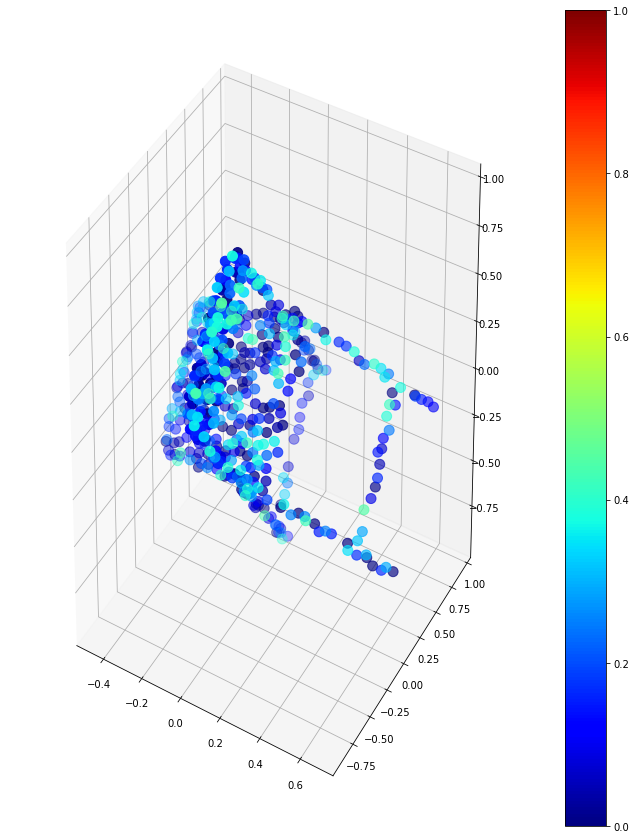

Cantidad de puntos:  507


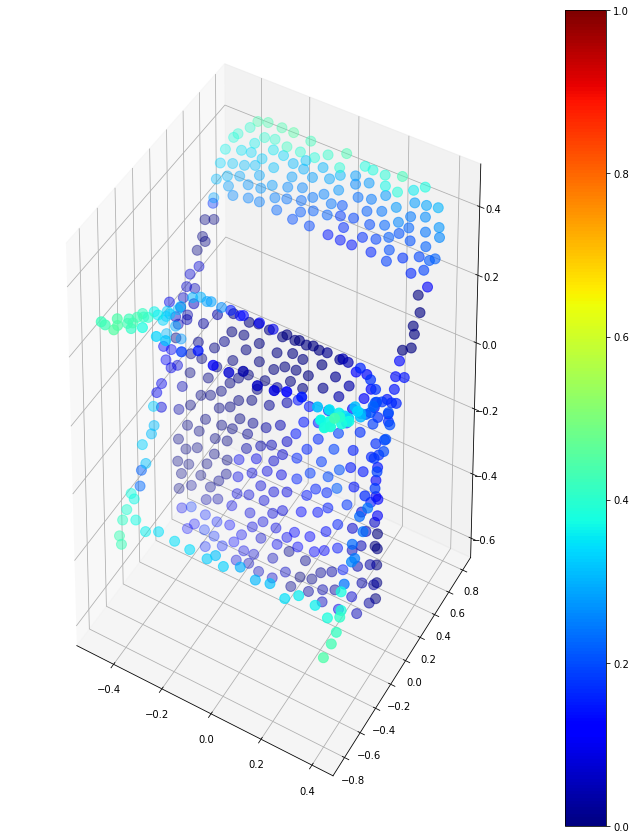

Cantidad de puntos:  507
ITERACION N°  0


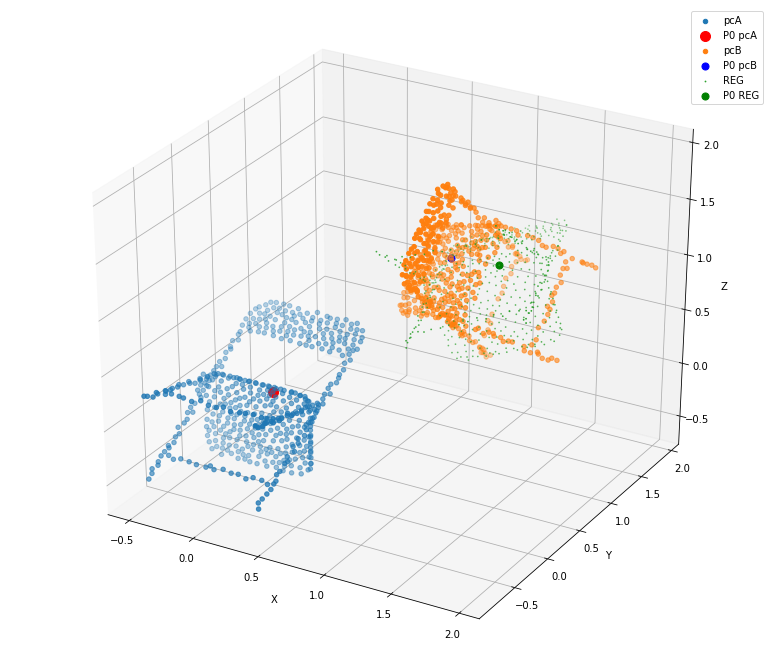

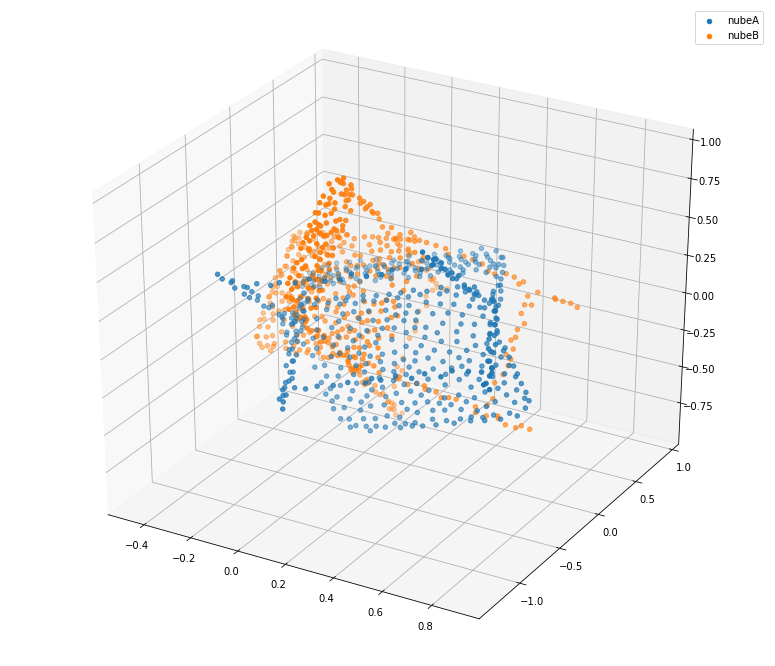

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


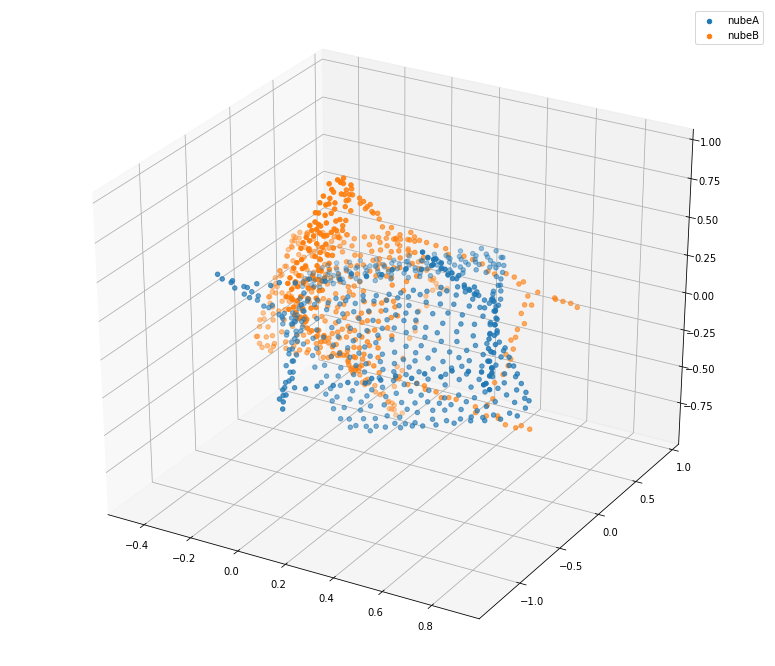

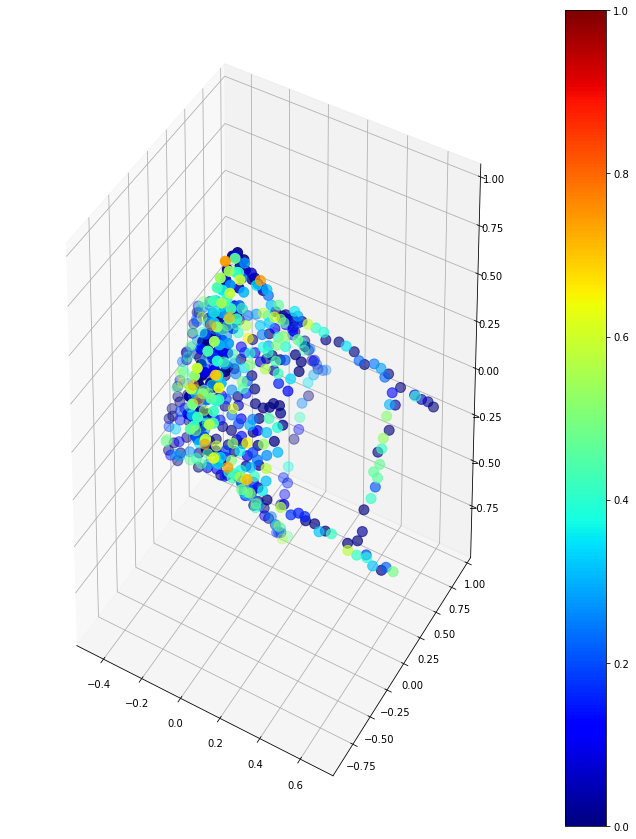

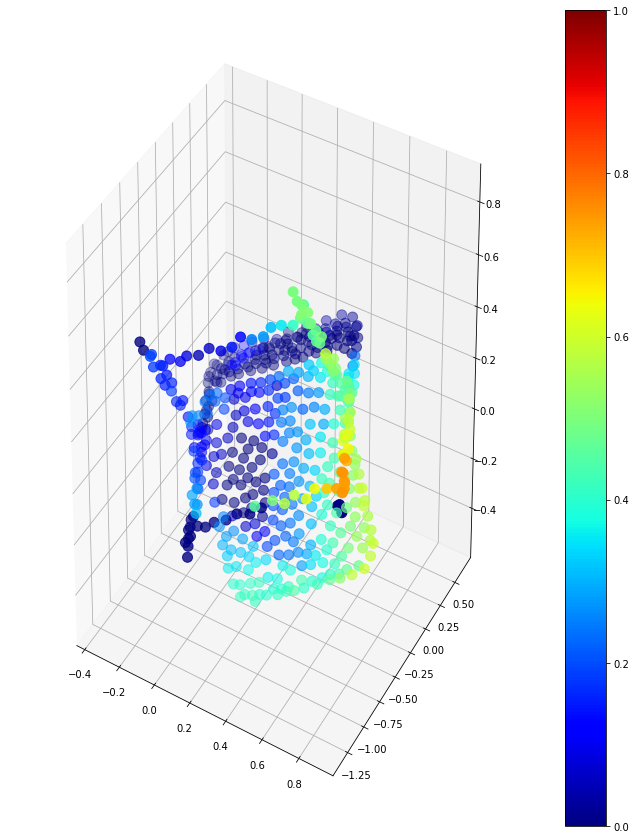

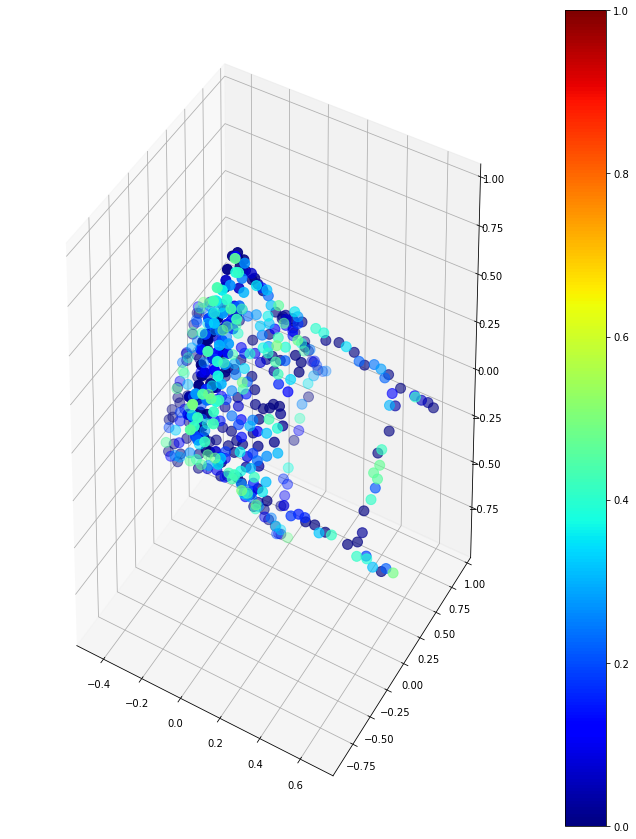

Cantidad de puntos:  453


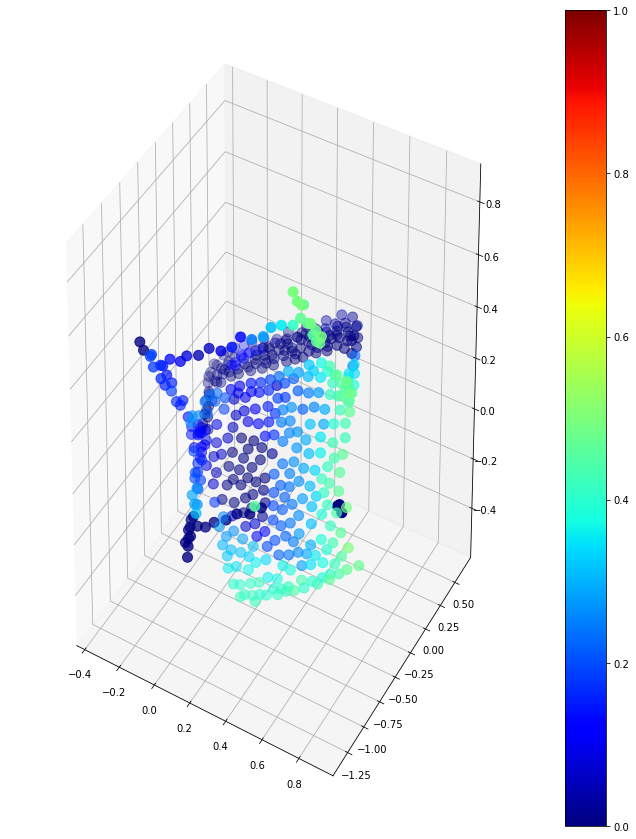

Cantidad de puntos:  453
ITERACION N°  1


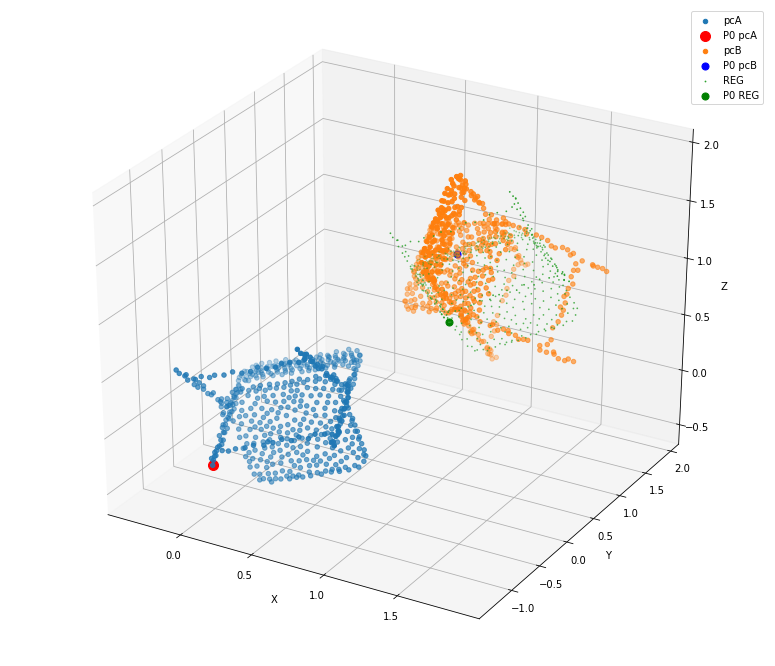

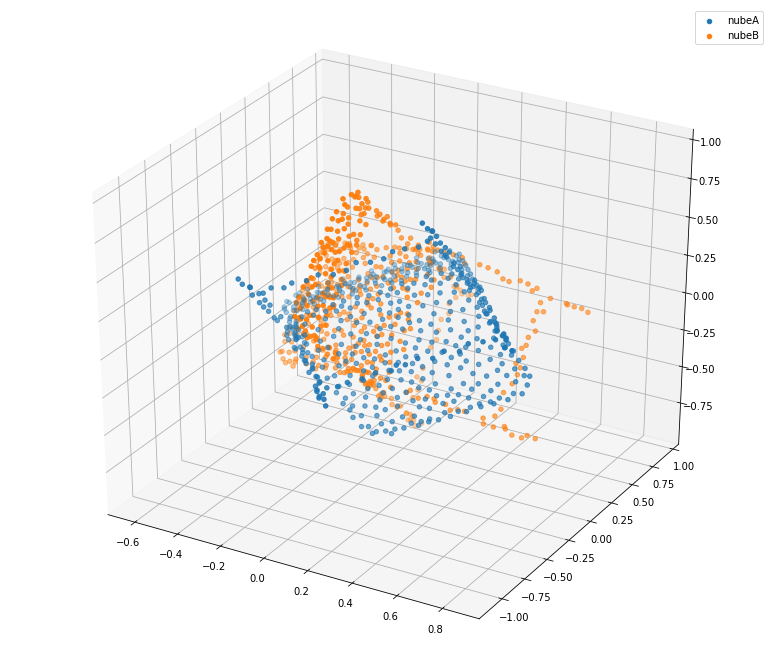

INFO:tensorflow:Restoring parameters from ./model.ckpt


/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


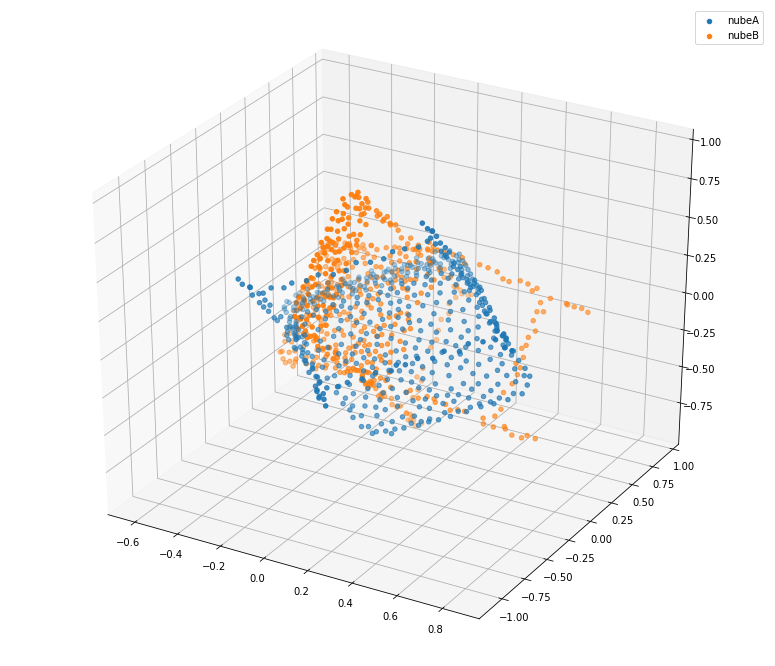

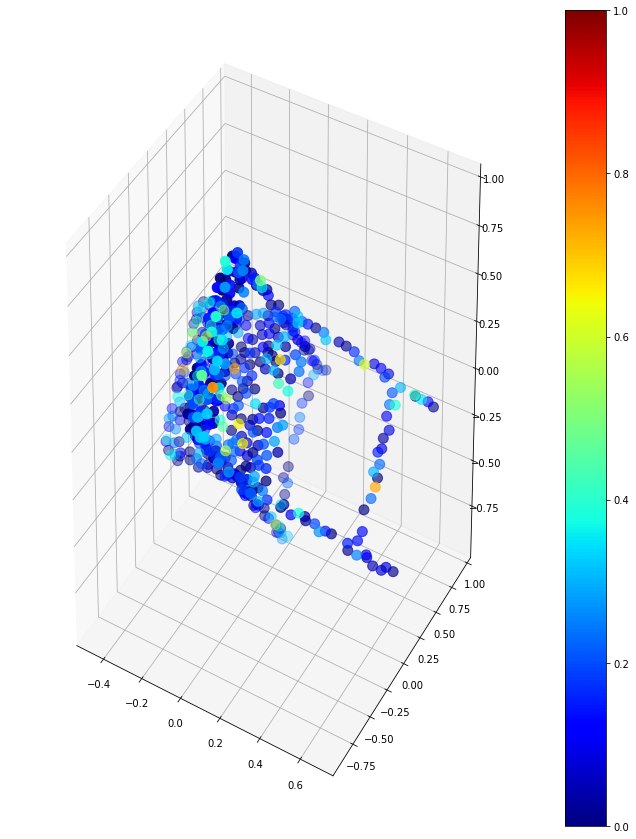

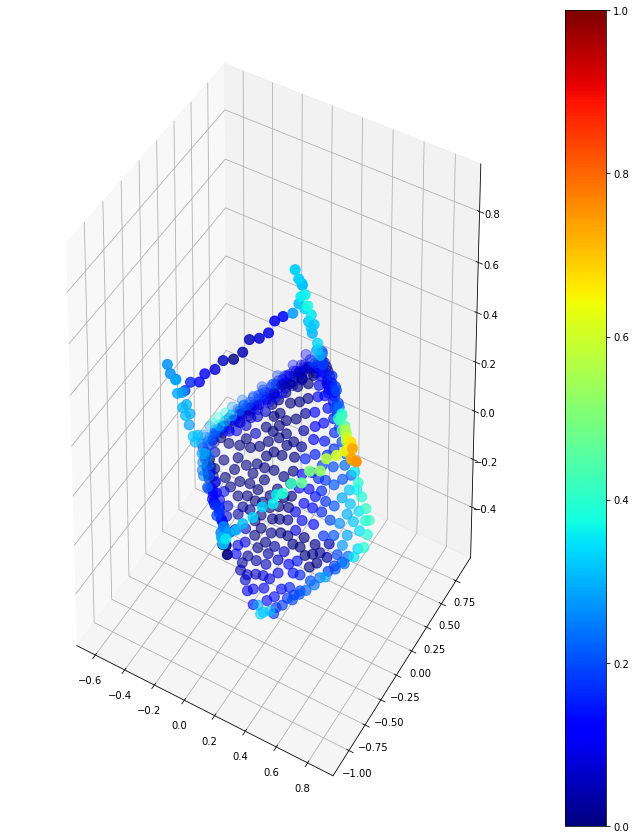

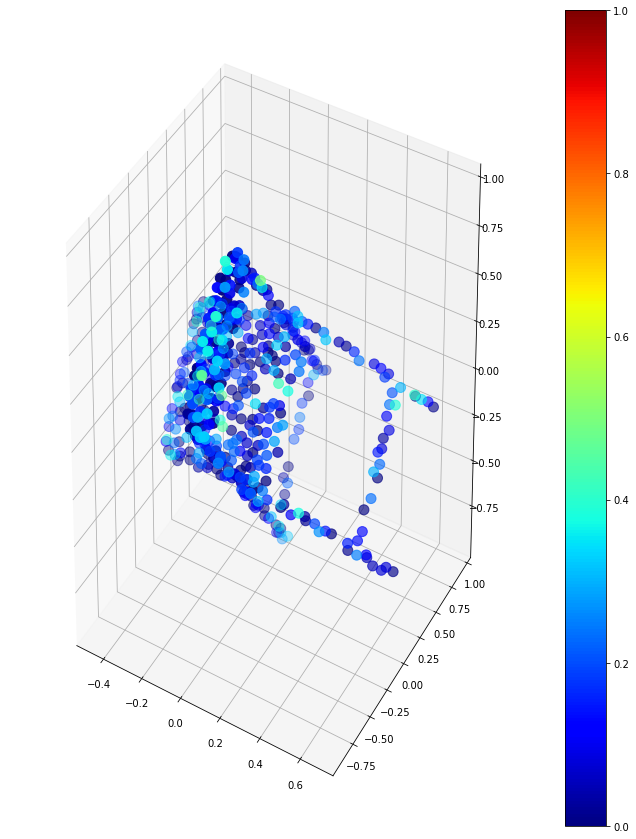

Cantidad de puntos:  497


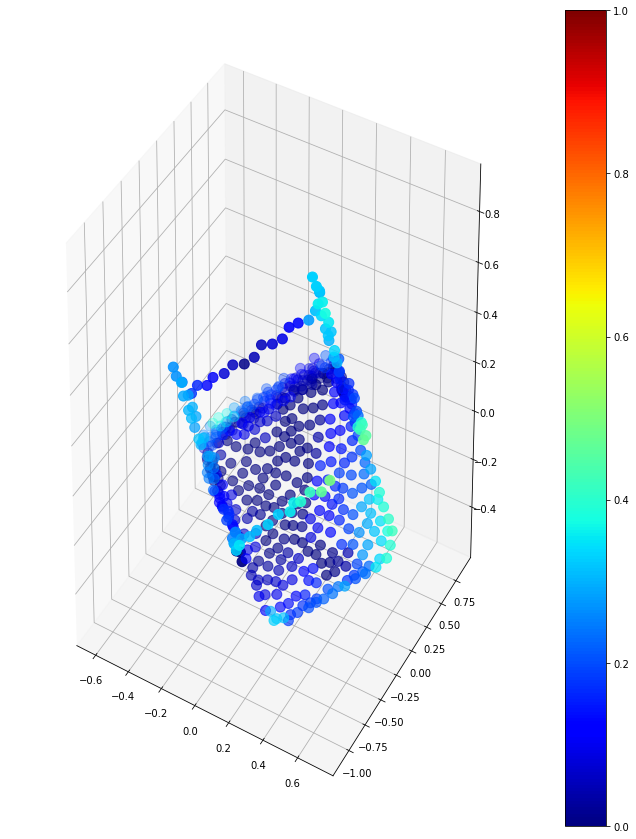

Cantidad de puntos:  497
ITERACION N°  2


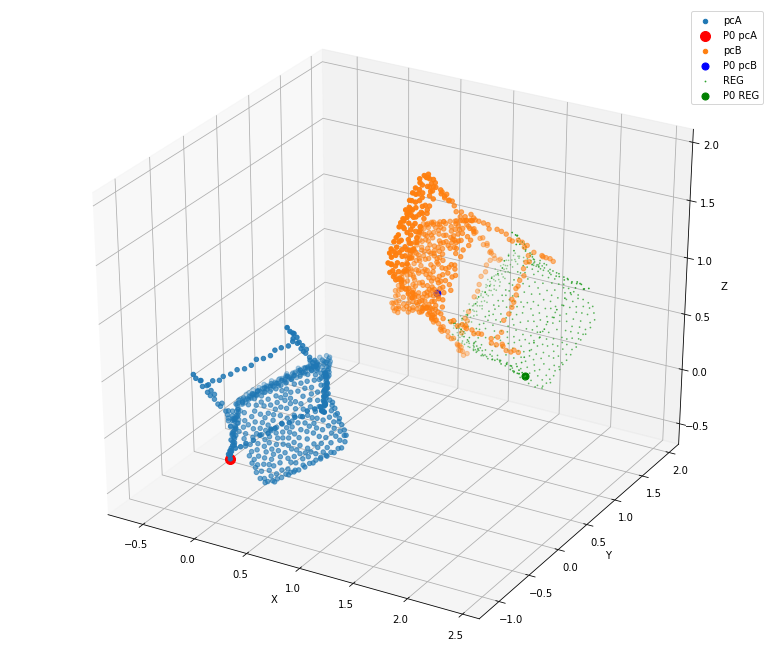

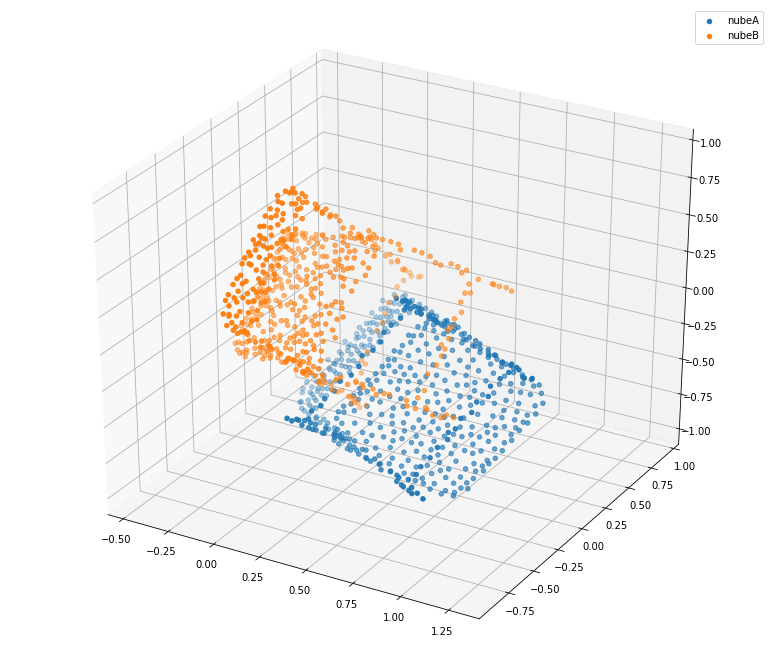

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


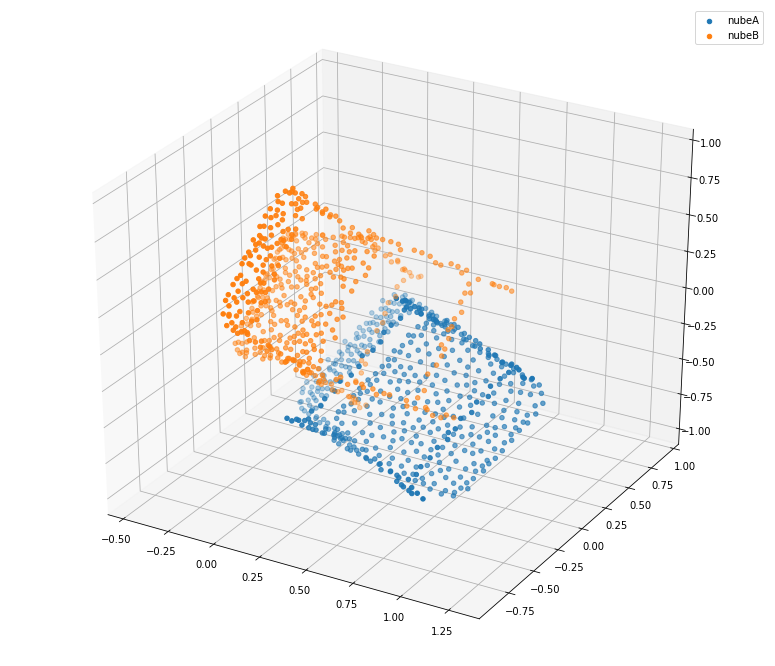

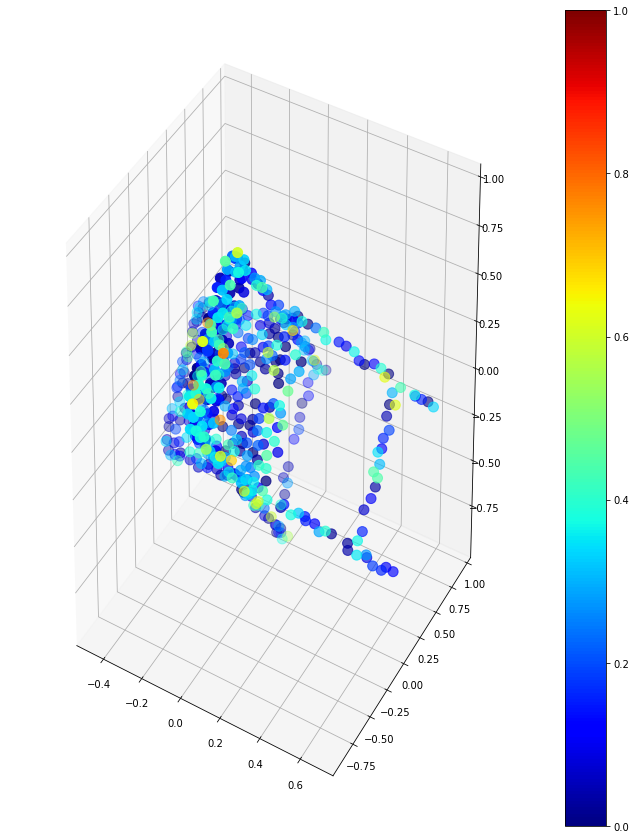

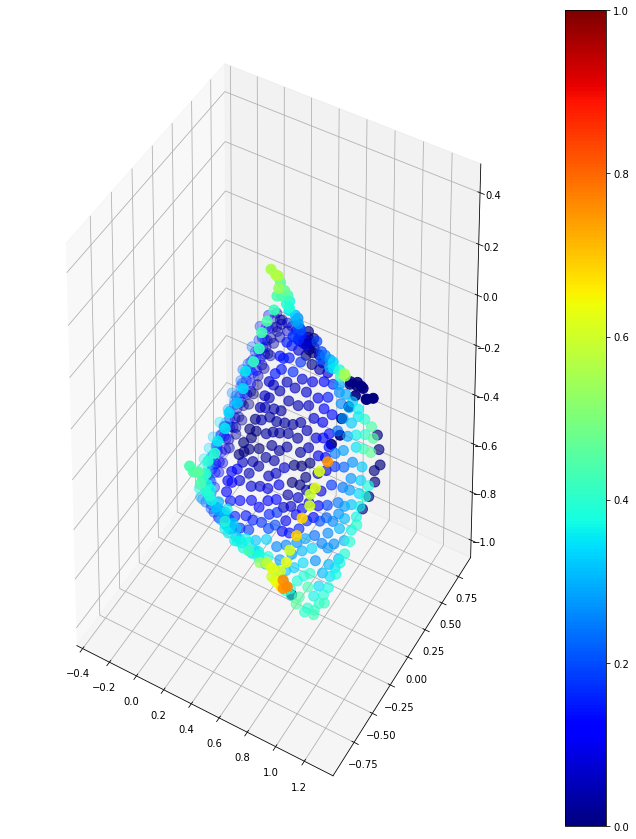

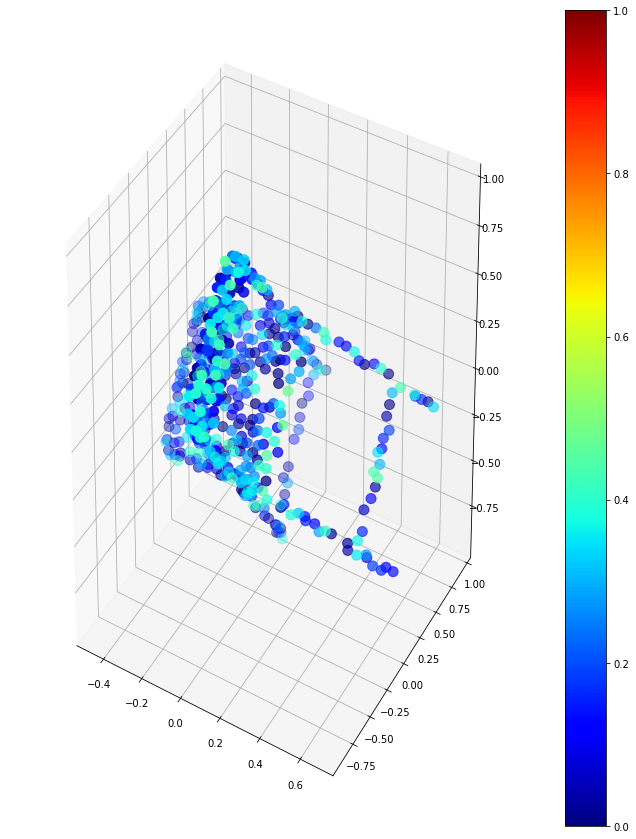

Cantidad de puntos:  483


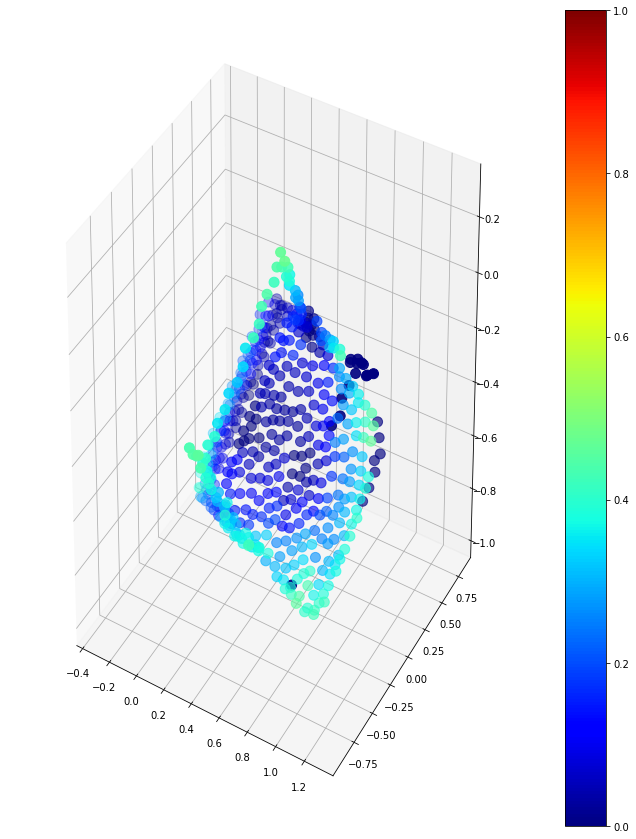

Cantidad de puntos:  483
ITERACION N°  3


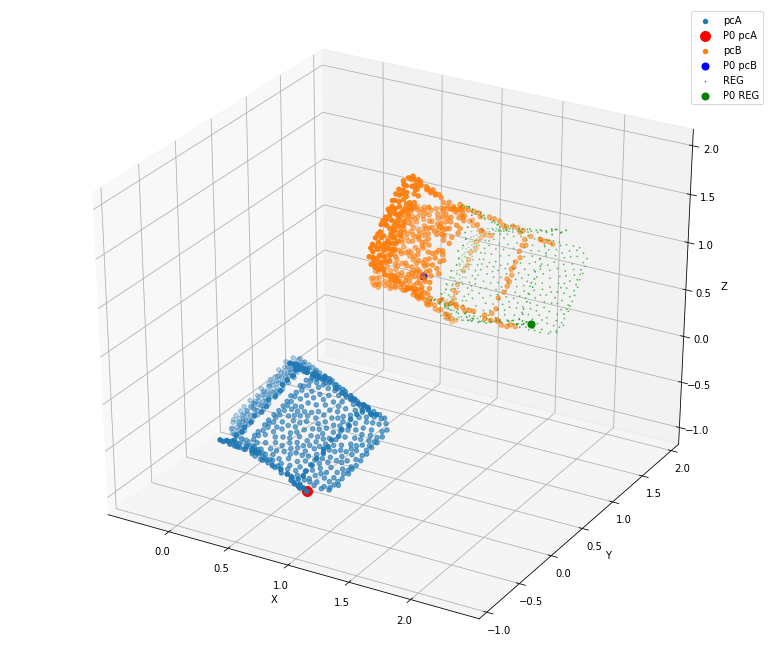

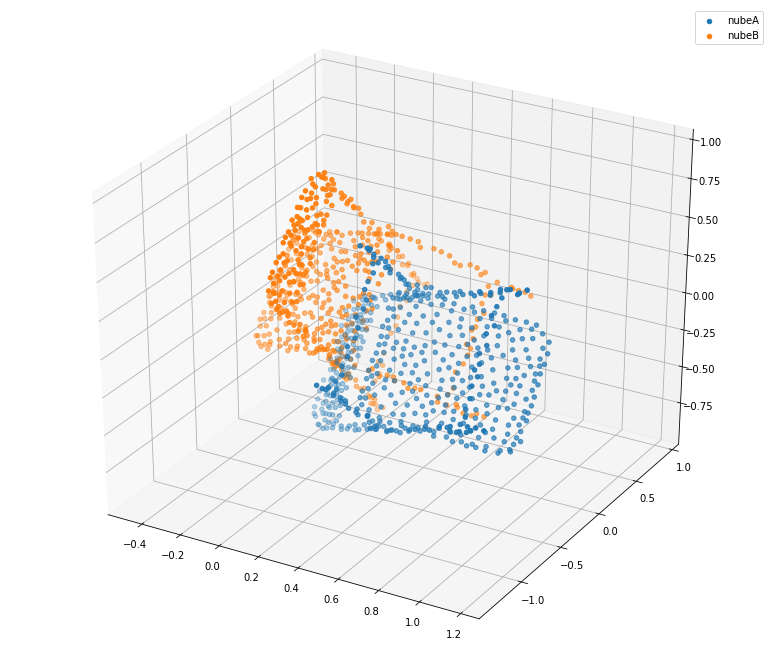

INFO:tensorflow:Restoring parameters from ./model.ckpt


/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


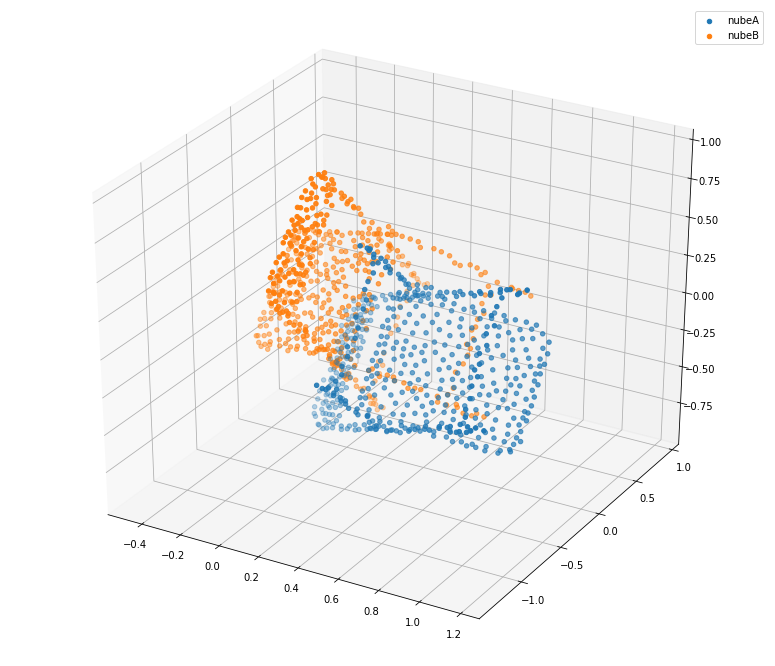

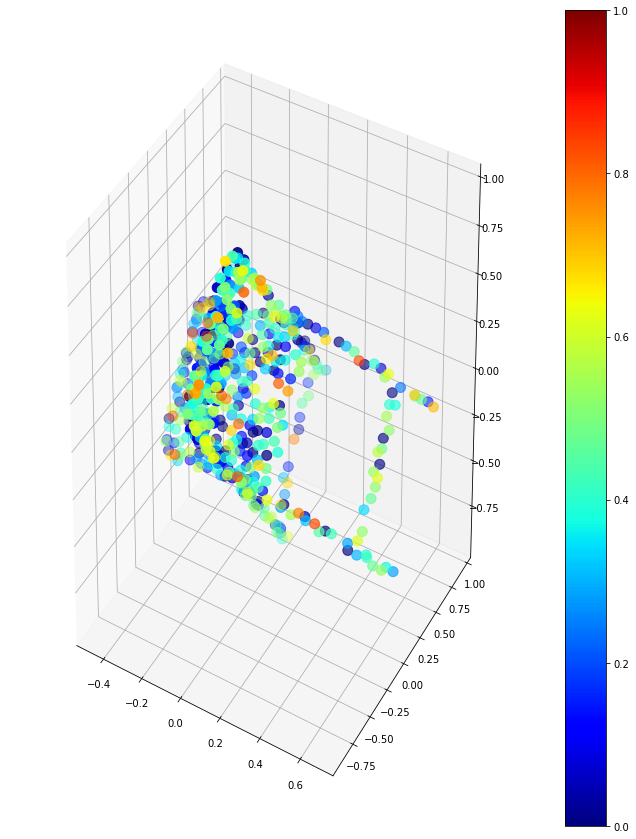

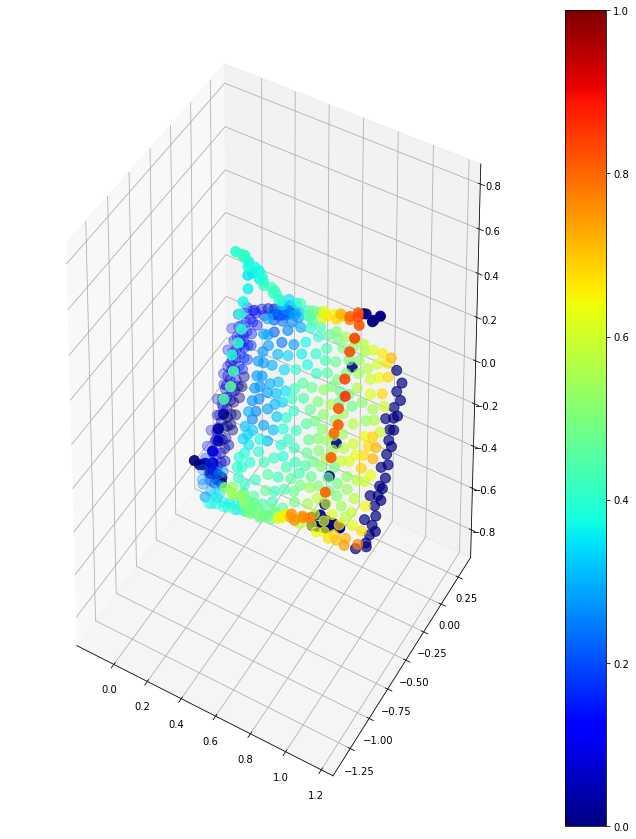

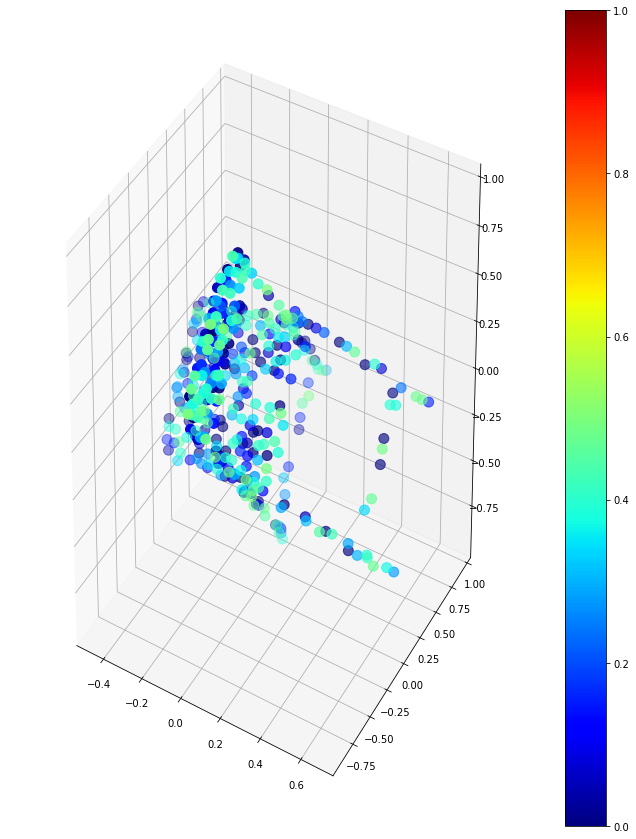

Cantidad de puntos:  383


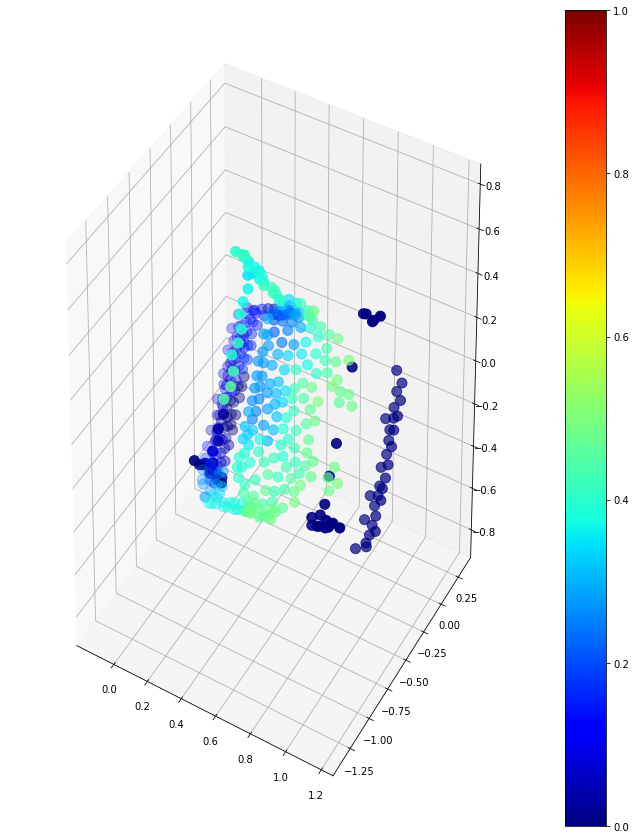

Cantidad de puntos:  383
ITERACION N°  4


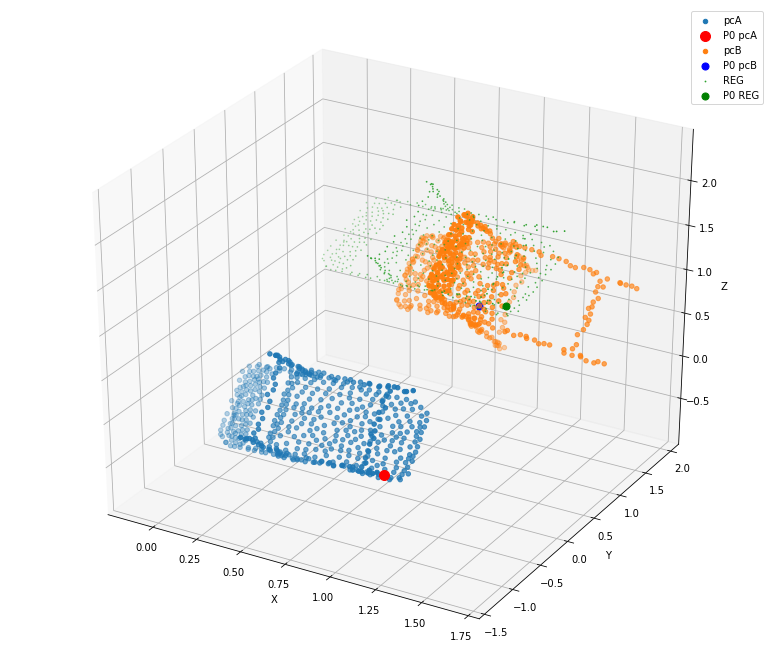

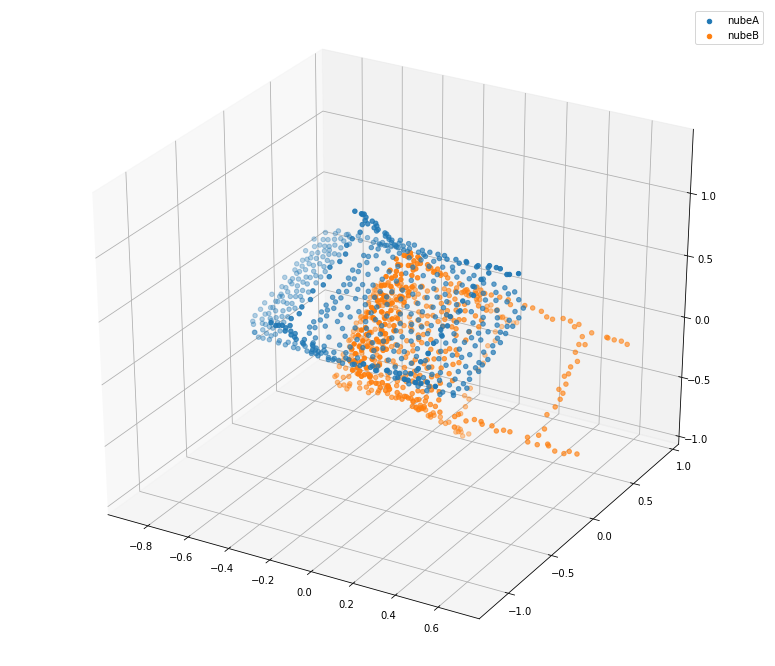

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


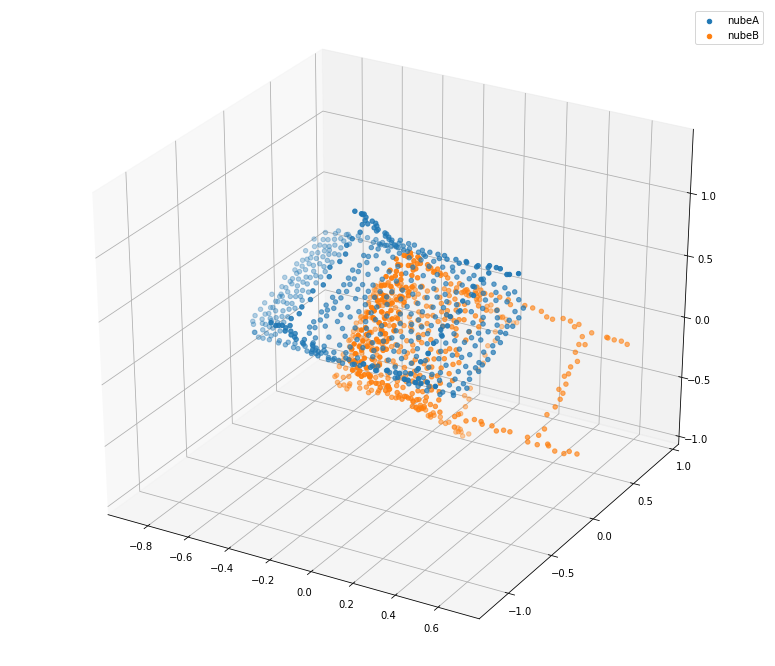

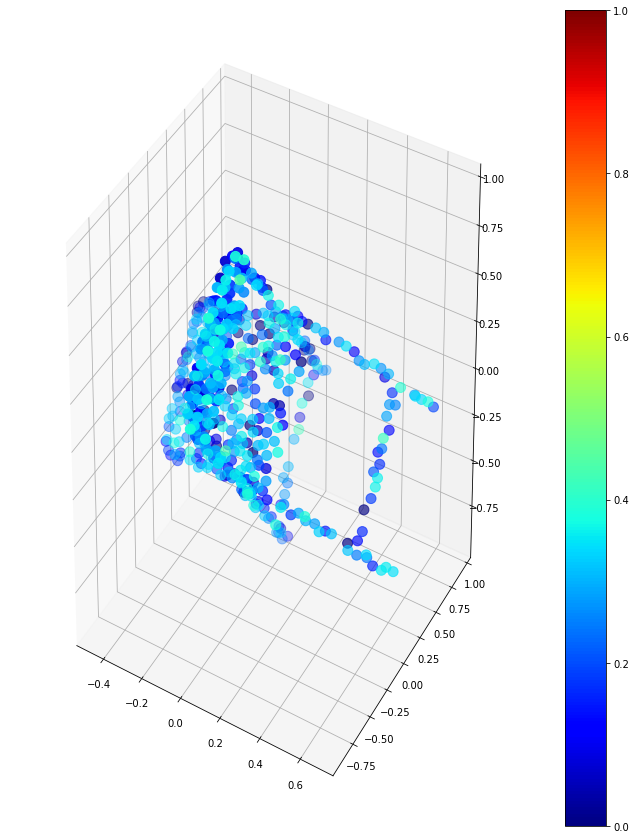

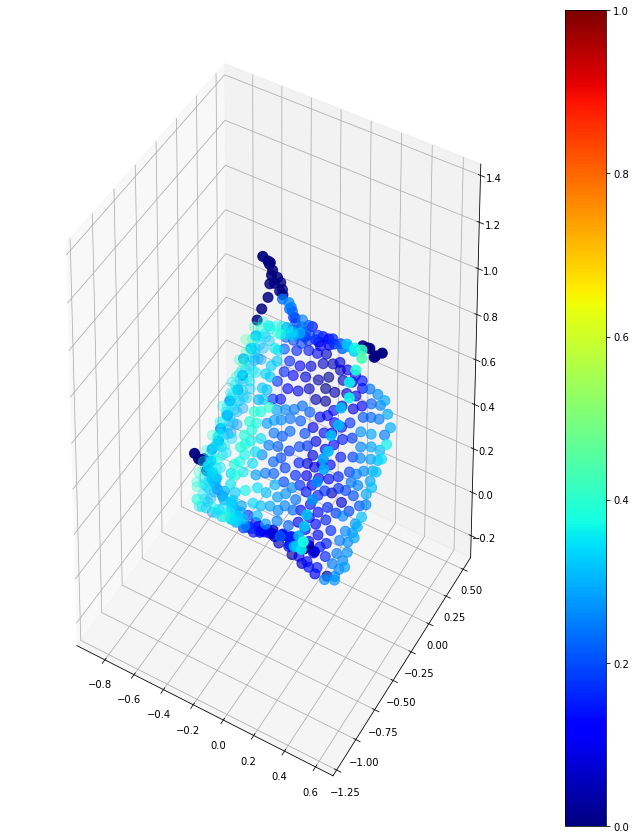

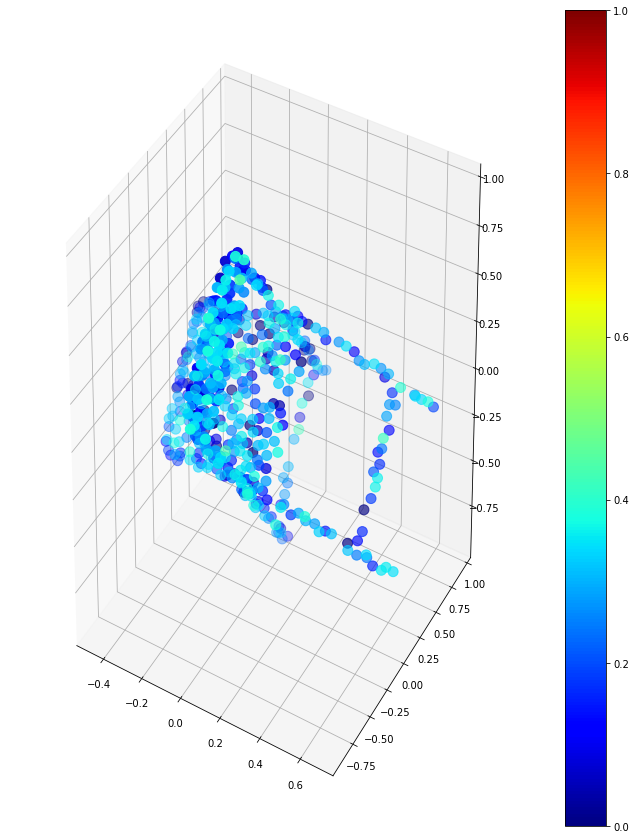

Cantidad de puntos:  512


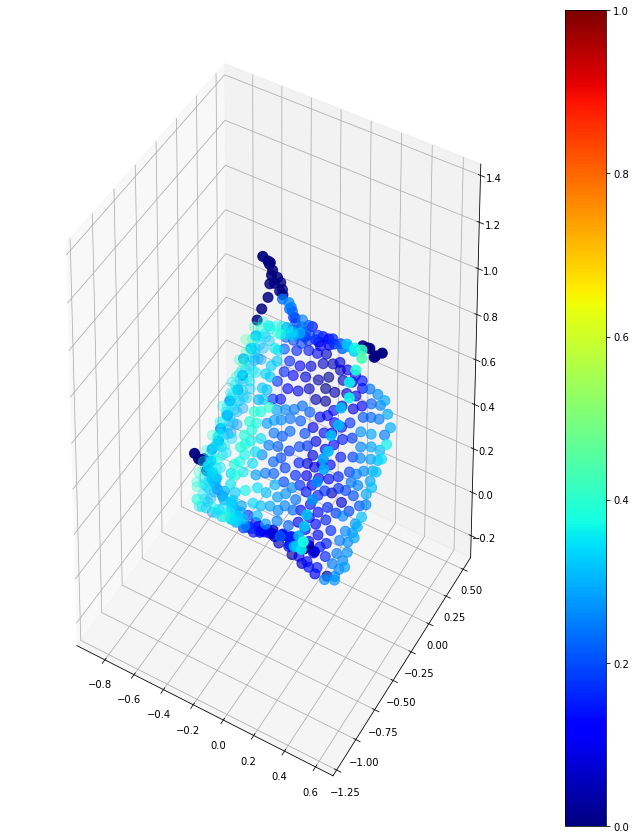

Cantidad de puntos:  512
ITERACION N°  5


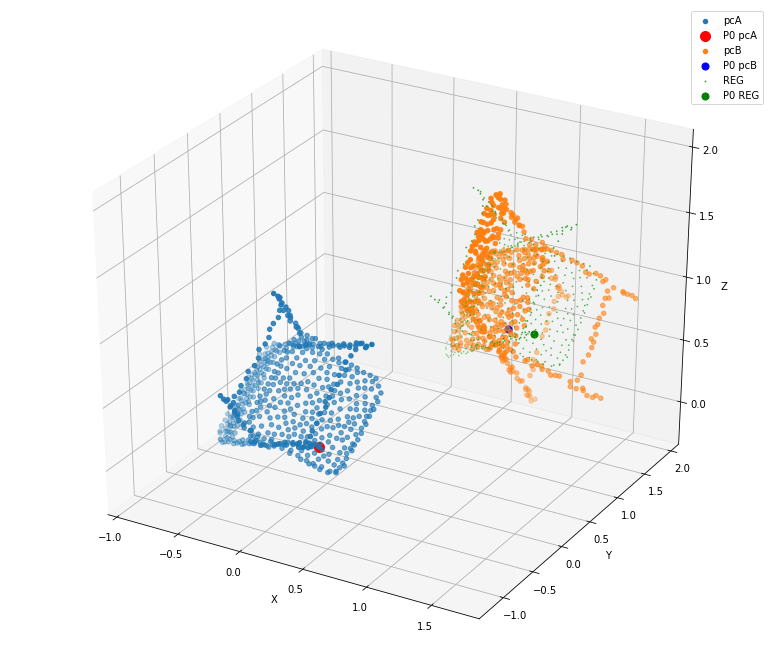

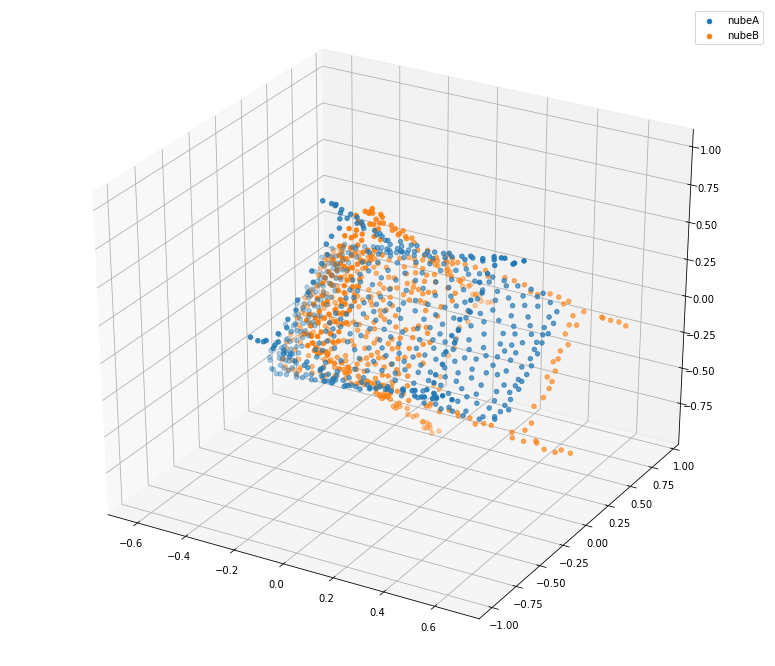

INFO:tensorflow:Restoring parameters from ./model.ckpt


/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


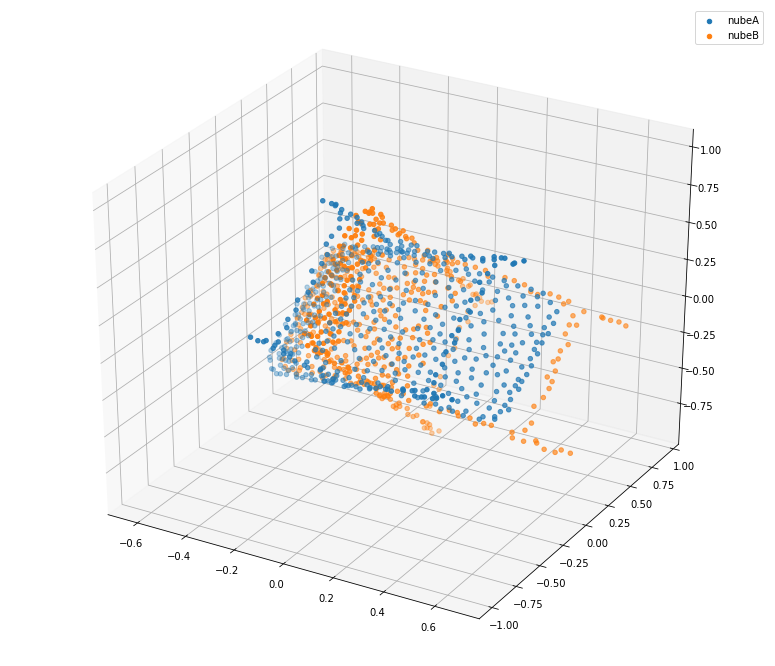

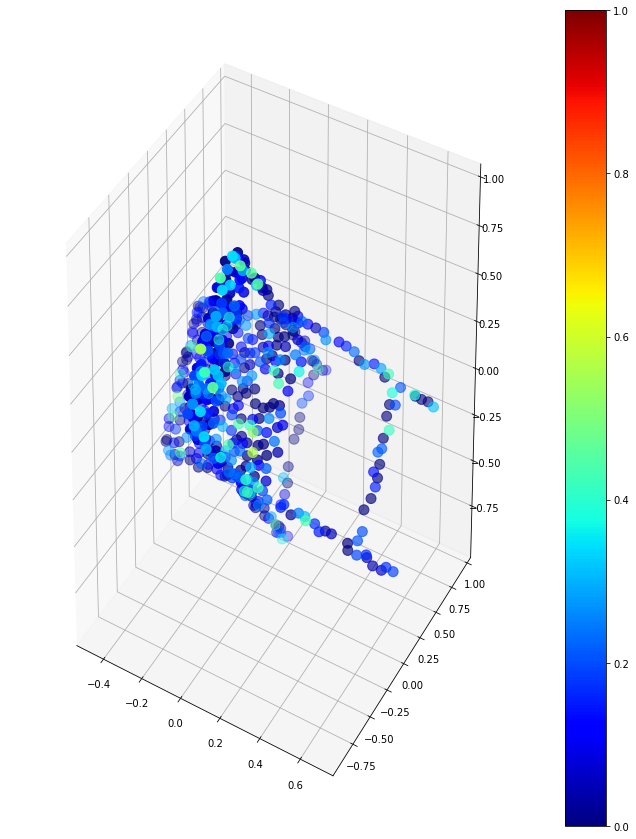

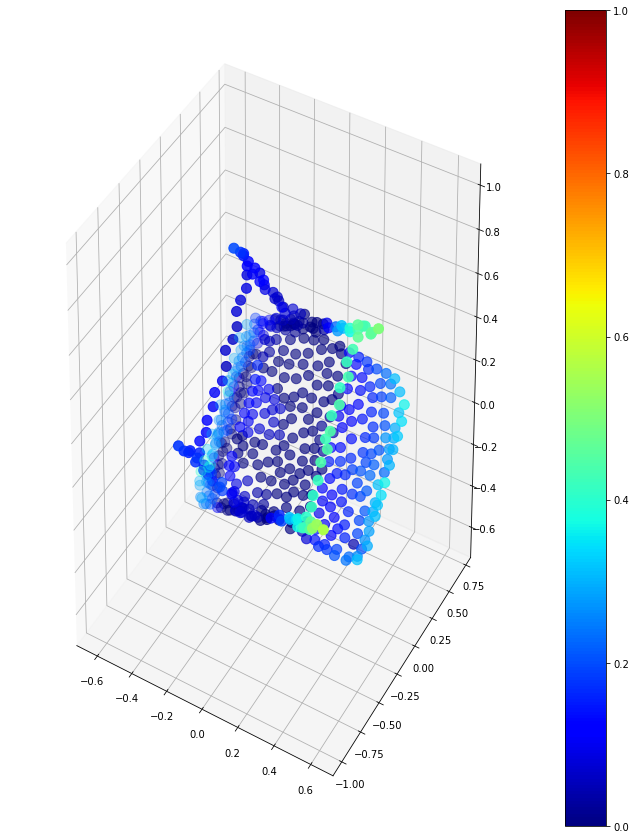

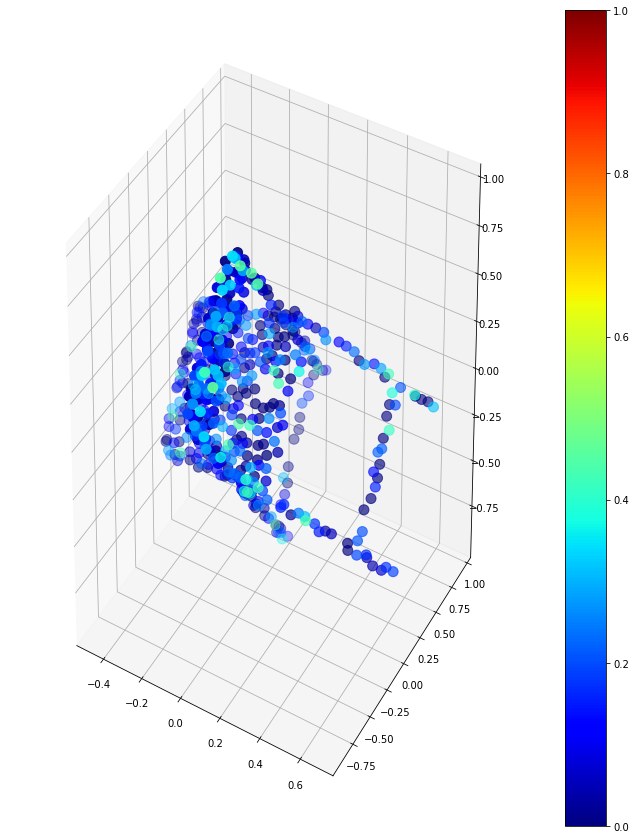

Cantidad de puntos:  508


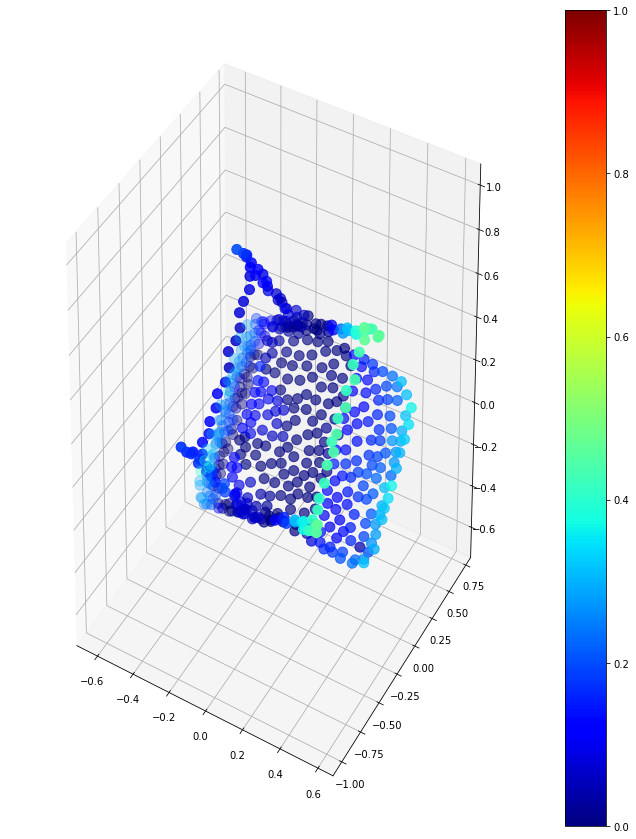

Cantidad de puntos:  508
ITERACION N°  6


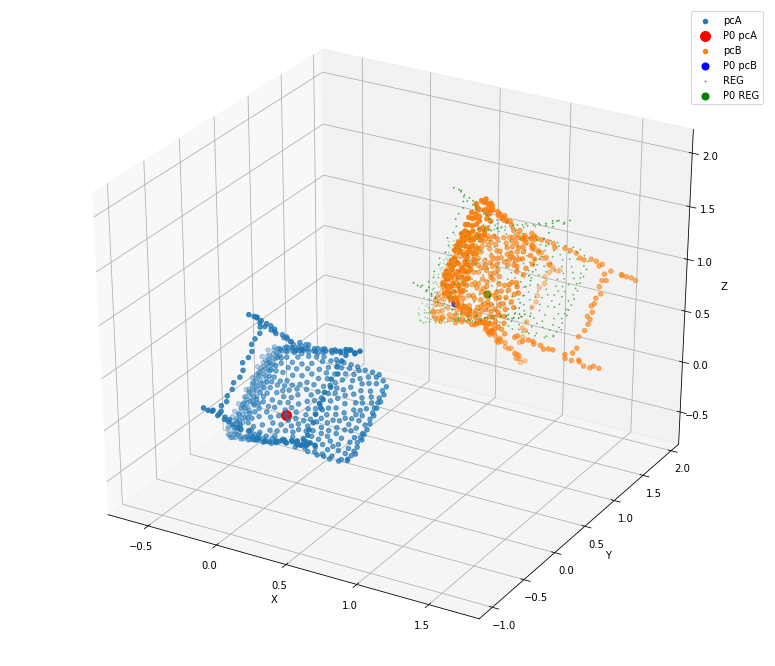

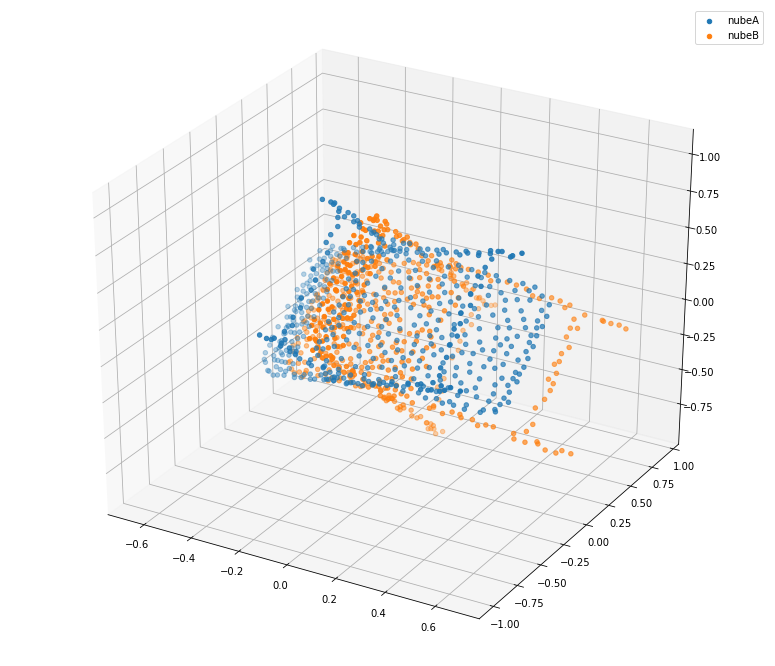

INFO:tensorflow:Restoring parameters from ./model.ckpt


/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


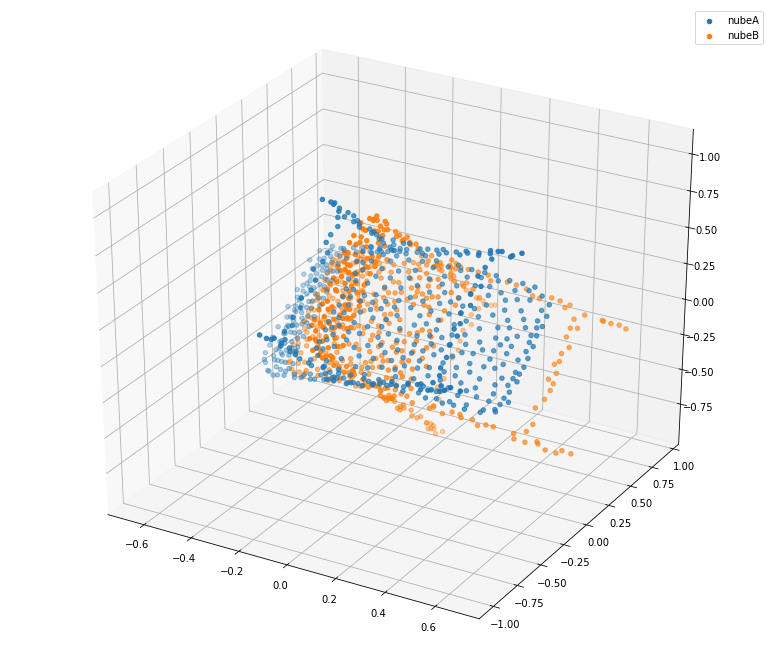

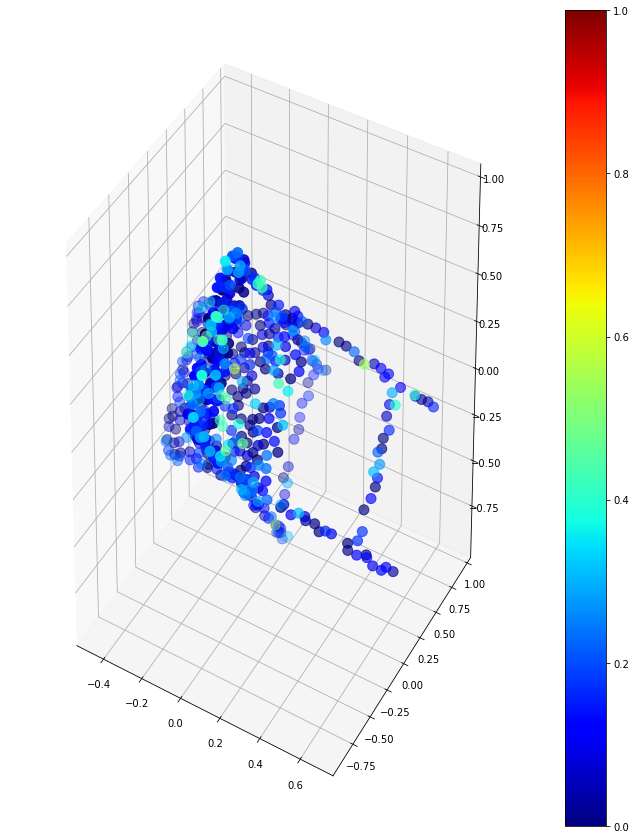

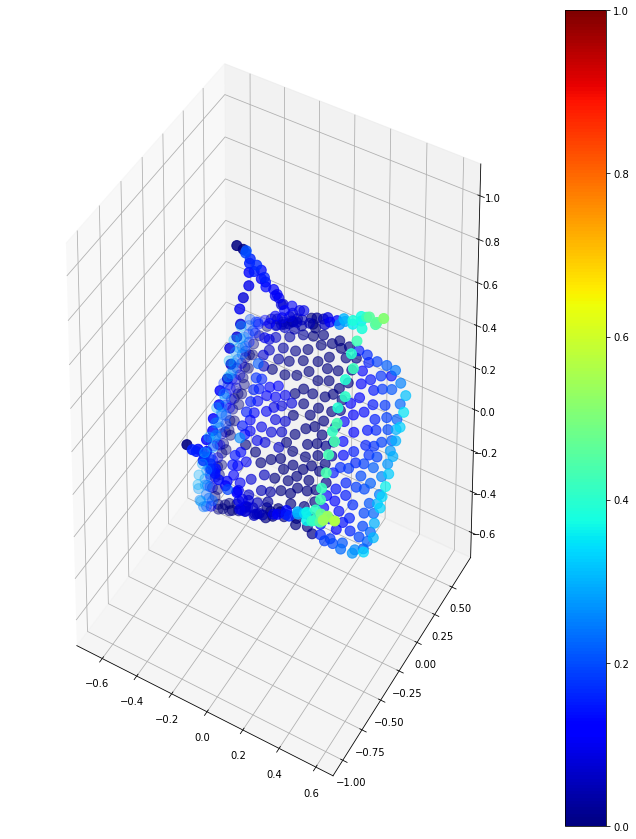

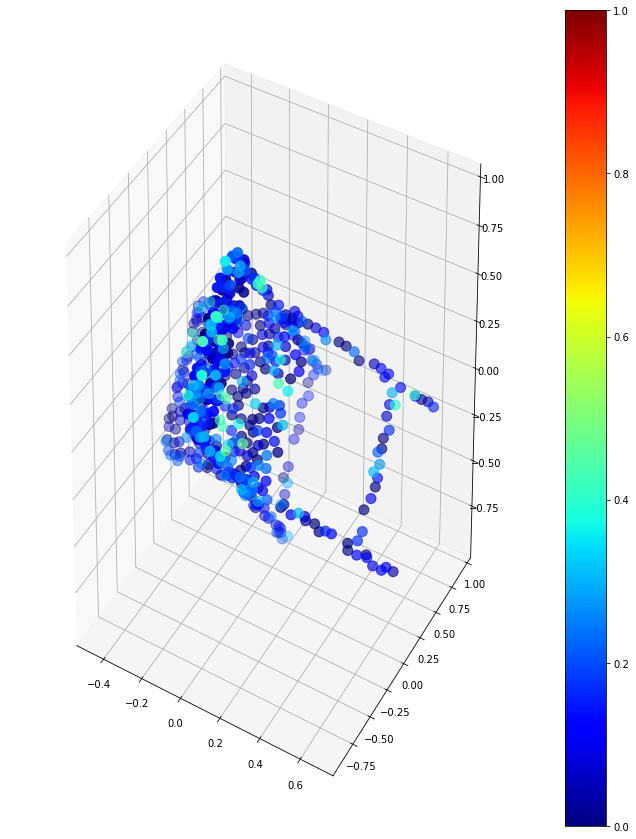

Cantidad de puntos:  508


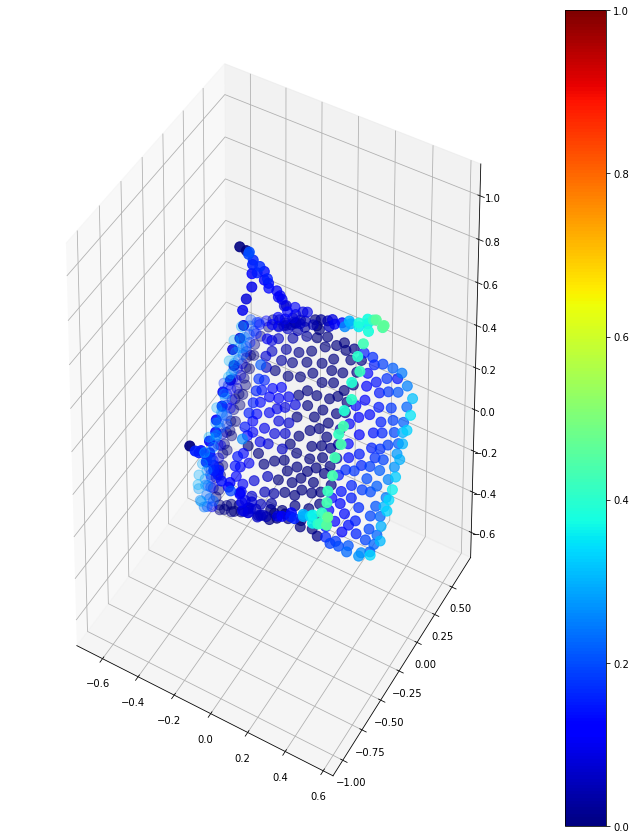

Cantidad de puntos:  508
ITERACION N°  7


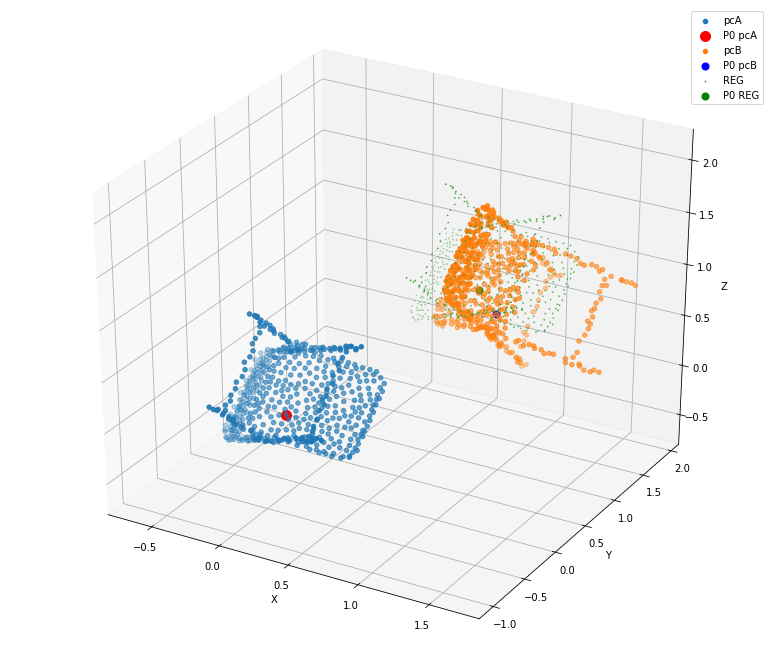

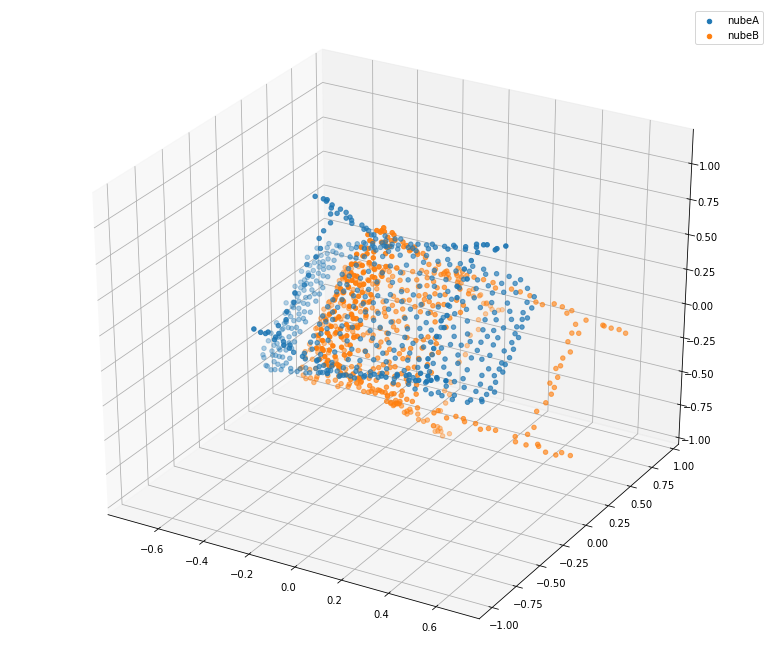

INFO:tensorflow:Restoring parameters from ./model.ckpt


/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


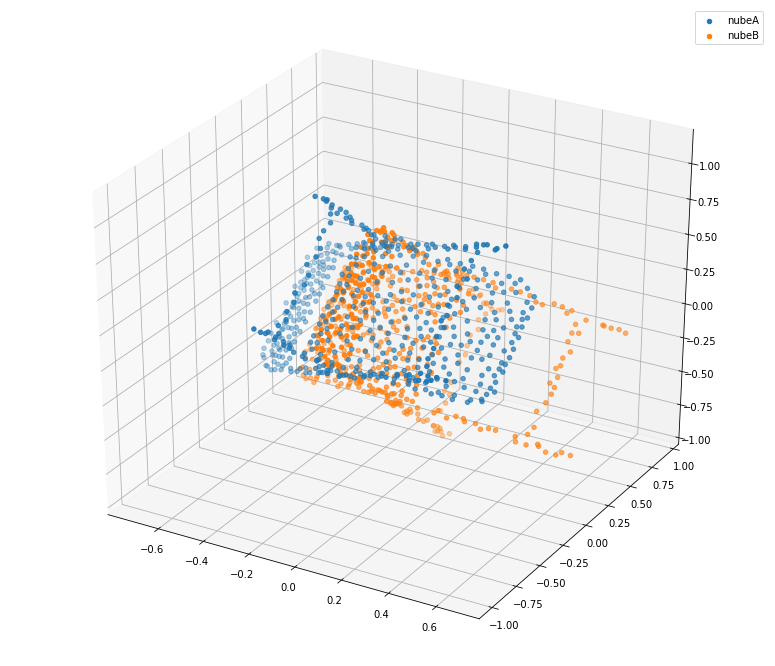

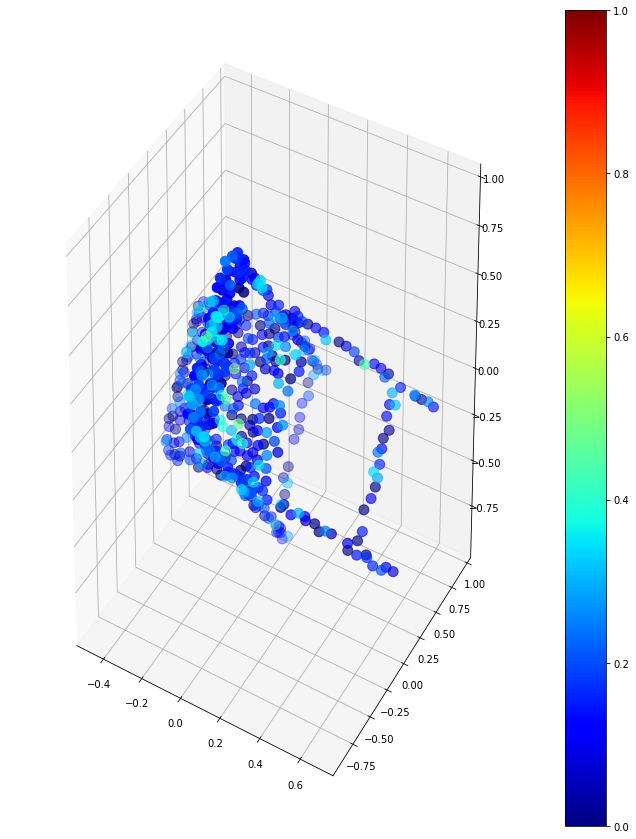

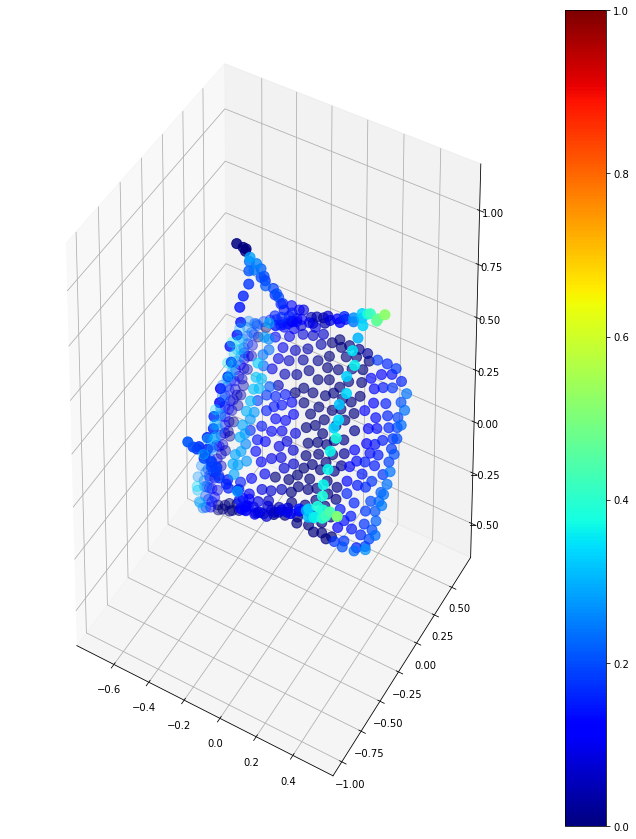

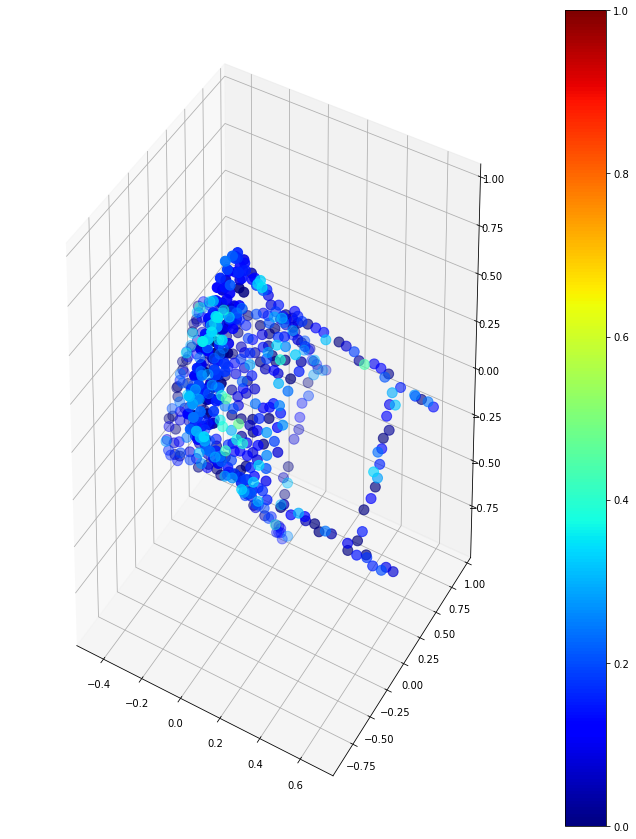

Cantidad de puntos:  510


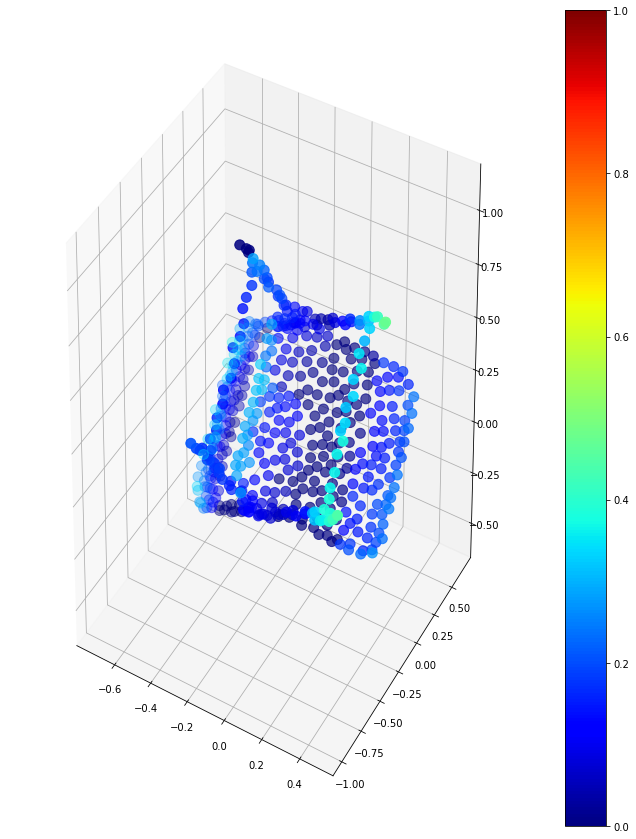

Cantidad de puntos:  510
ITERACION N°  8


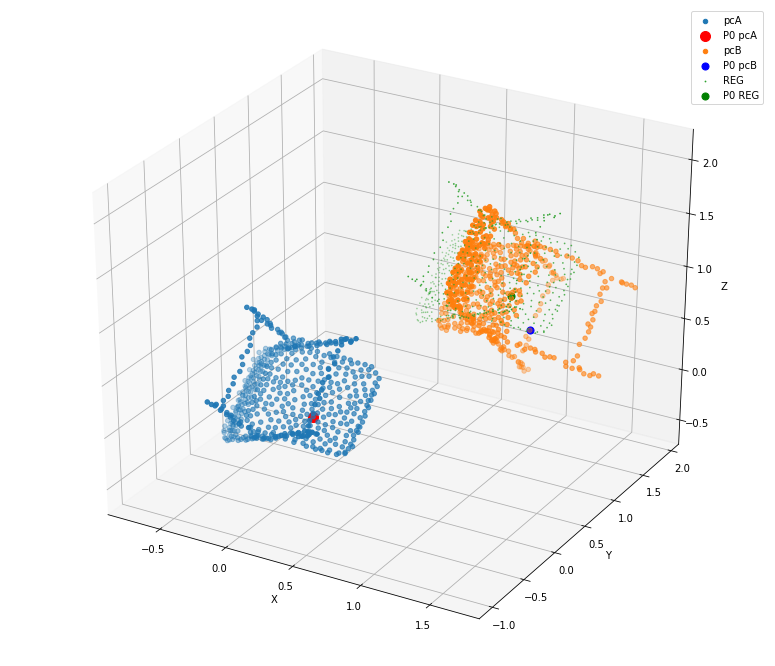

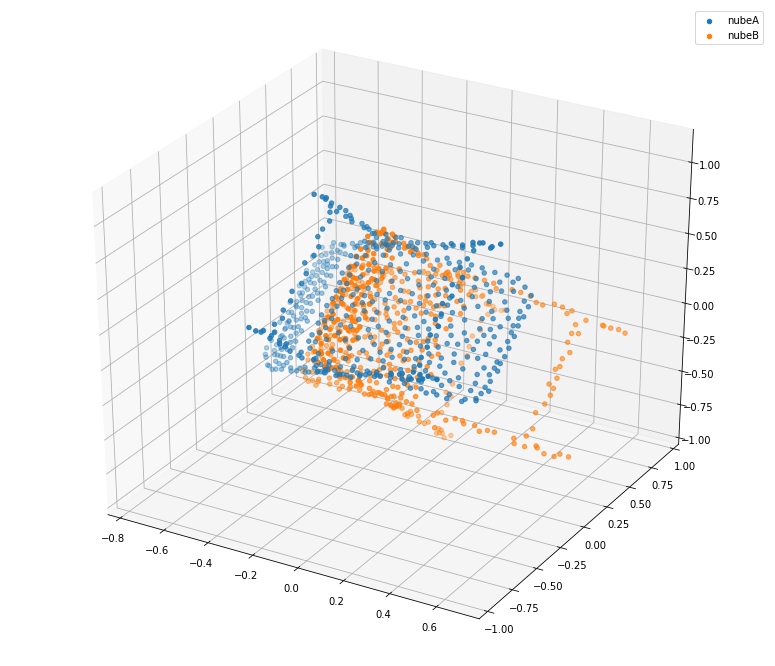

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


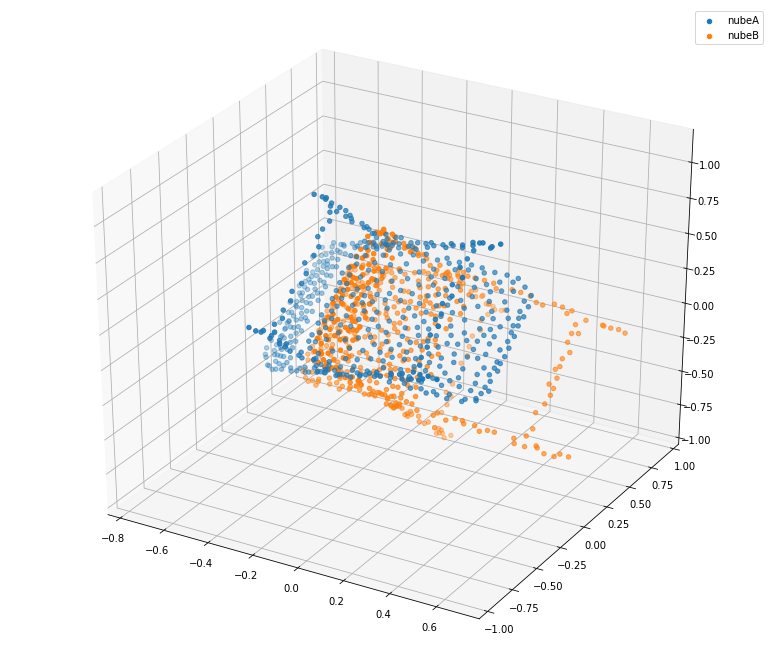

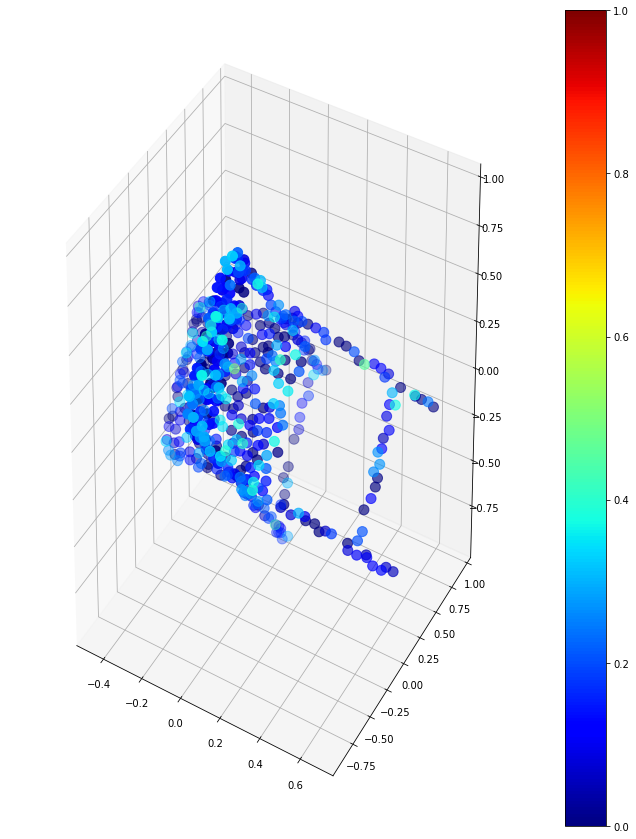

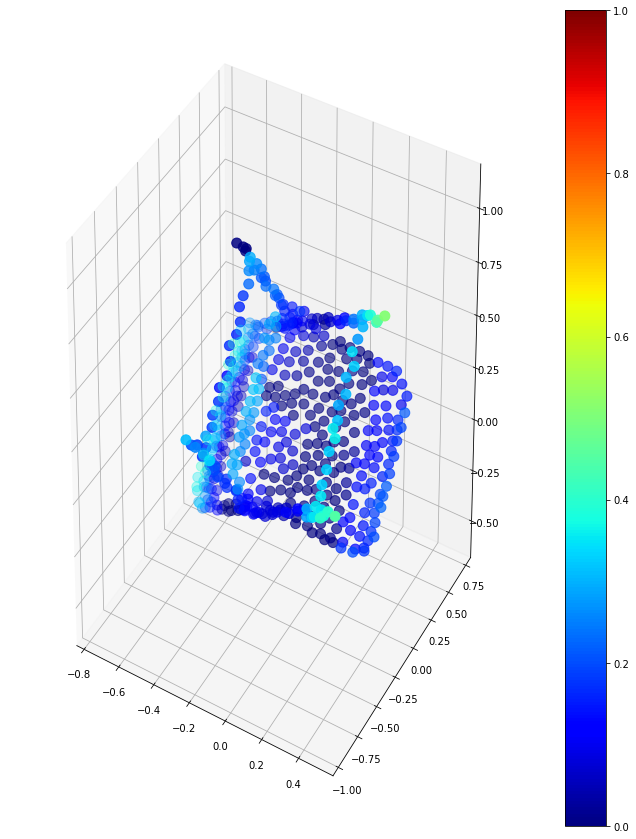

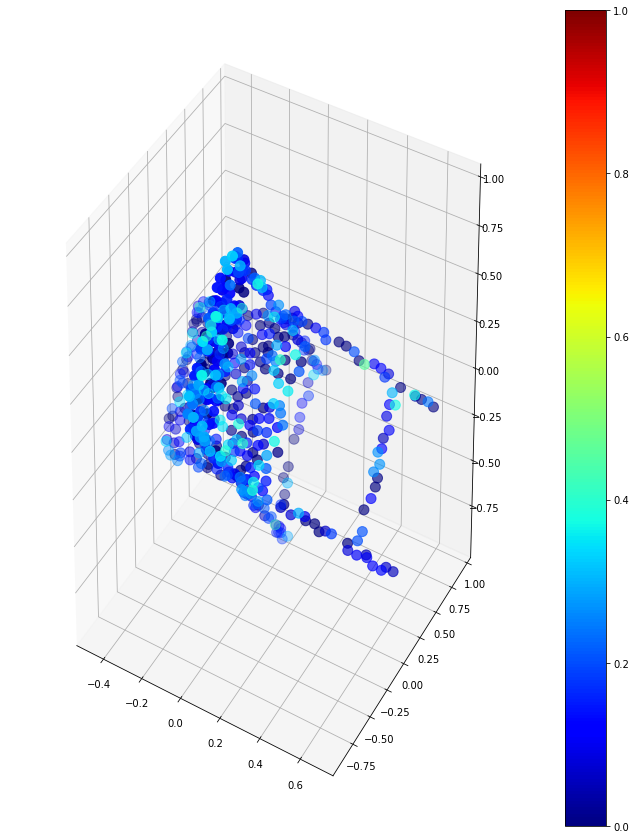

Cantidad de puntos:  511


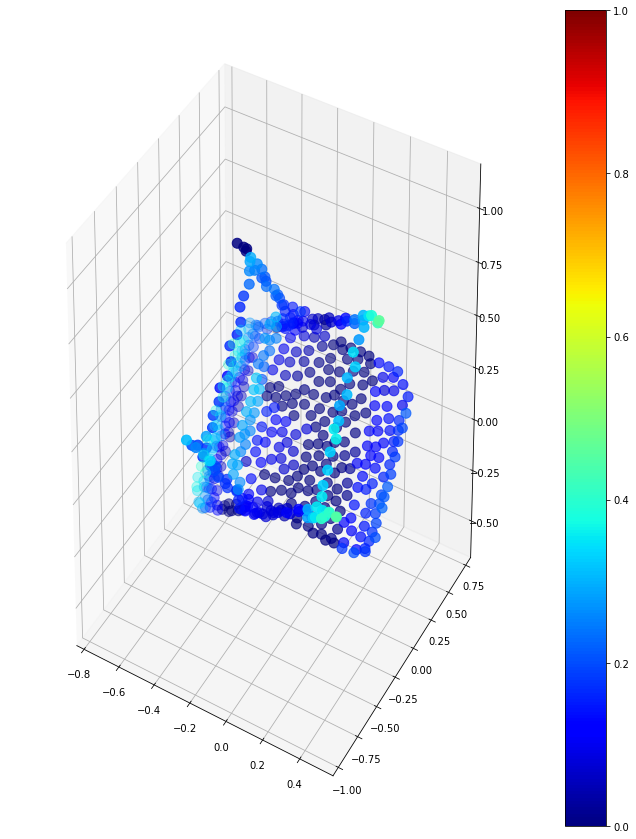

Cantidad de puntos:  511
ITERACION N°  9


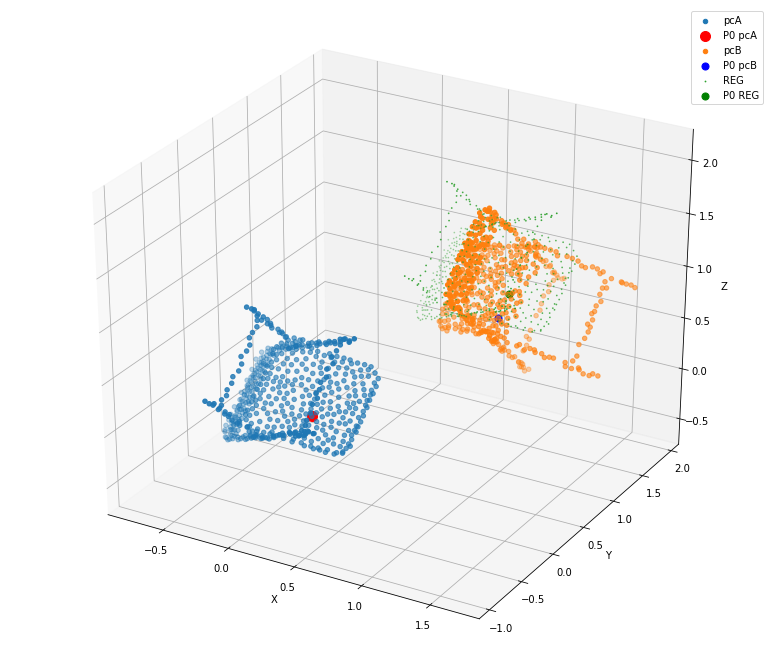

In [ ]:
algoritmoNuestro(point_cloud_A, point_cloud_B, 10)

In [ ]:
point_cloud_A = chair[0][0:1024]
Rm = rotacionZYX(0, 0, 0) 
t = 1
point_cloud_B= np.dot(Rm, chair[0][1024:1024*2].T).T + t

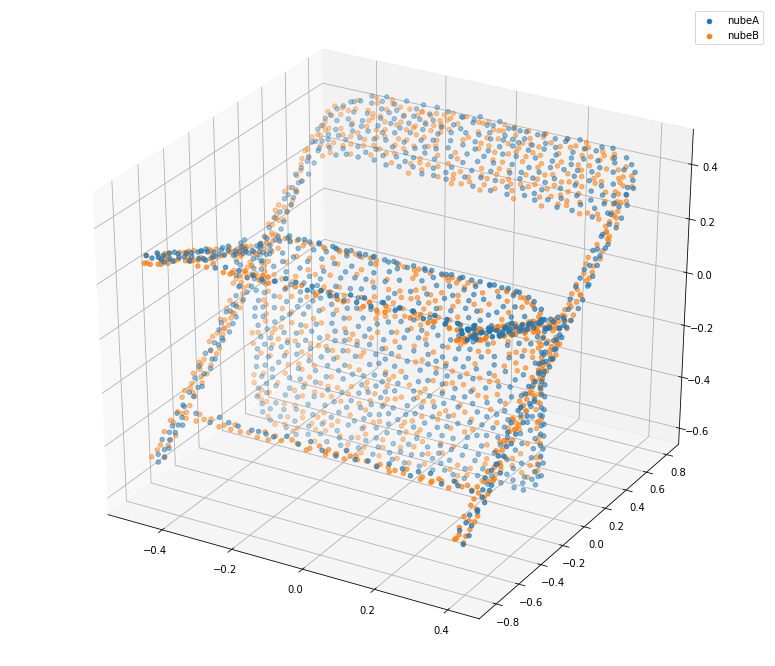

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


In [ ]:
pcAc = point_cloud_A-np.mean(point_cloud_A)
pcBc = point_cloud_B-np.mean(point_cloud_B)
plottearNubes(pcAc, pcBc, 'Nubes Centradas')

vectDistAB, vectDistBA = DPDIST(pcAc, pcBc)
vectDistBA = vectDistBA.reshape(1024,3)
vectDistAB =vectDistAB.reshape(1024,3)  
normAB, normBA, DistPC_PC = DPDISTnormaAndDistPc_Pc(vectDistAB, vectDistBA)

In [ ]:
np.mean(vectDistBA[:,0])

0.011073777

In [ ]:
np.mean(vectDistBA[:,1])

0.01056462

In [ ]:
np.mean(vectDistAB[:,0])

0.01333347

In [ ]:
np.mean(vectDistAB[:,1])

0.010229744

In [ ]:
vectDistAB

array([[0.        , 0.        , 0.        ],
       [0.        , 0.02874719, 0.        ],
       [0.        , 0.01686652, 0.        ],
       ...,
       [0.        , 0.01168299, 0.        ],
       [0.05251177, 0.03268388, 0.        ],
       [0.        , 0.03338519, 0.        ]], dtype=float32)

In [ ]:
vectDistBA

array([[0.        , 0.        , 0.        ],
       [0.02588805, 0.        , 0.        ],
       [0.03030138, 0.02392525, 0.        ],
       ...,
       [0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        ],
       [0.        , 0.02584178, 0.        ]], dtype=float32)

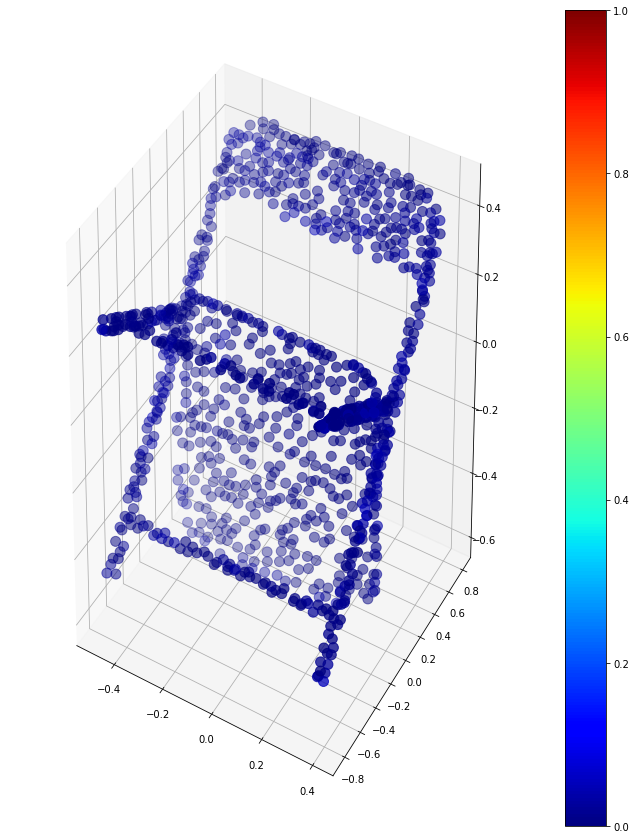

Cantidad de puntos:  1024


In [ ]:
puntosAB = plottear_DPDist_cercanos(vectDistAB[:,1], pcBc, 0.5)

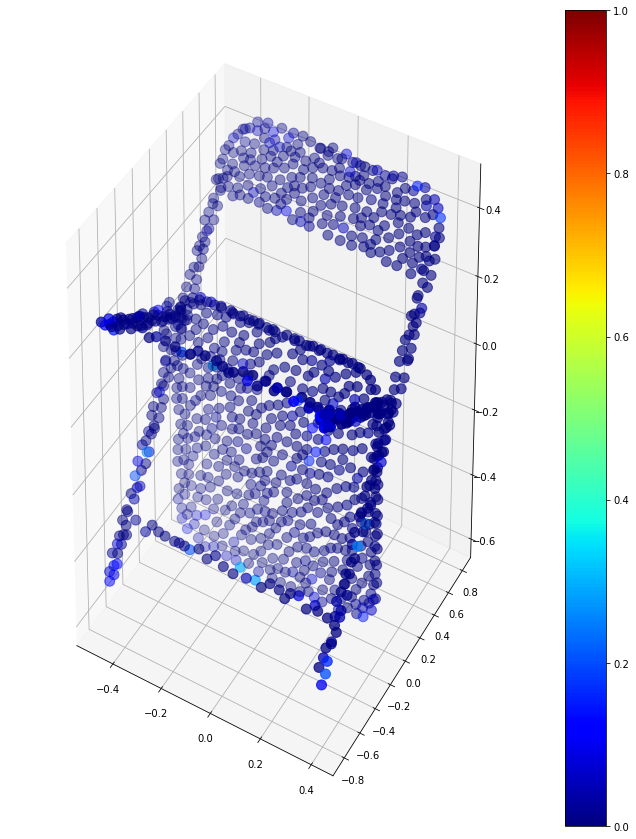

Cantidad de puntos:  1024


In [ ]:
puntosAB = plottear_DPDist_cercanos(vectDistBA[:,0], pcAc, 0.5)

In [ ]:
DistABord, pcAcOrd = ord_by_menores_distancias(vectDistBA[:,1], pcAc)
DistBAord, pcBcOrd = ord_by_menores_distancias(vectDistAB[:,1], pcBc)
pcAcOrd = np.array(pcAcOrd)
pcBcOrd = np.array(pcBcOrd)

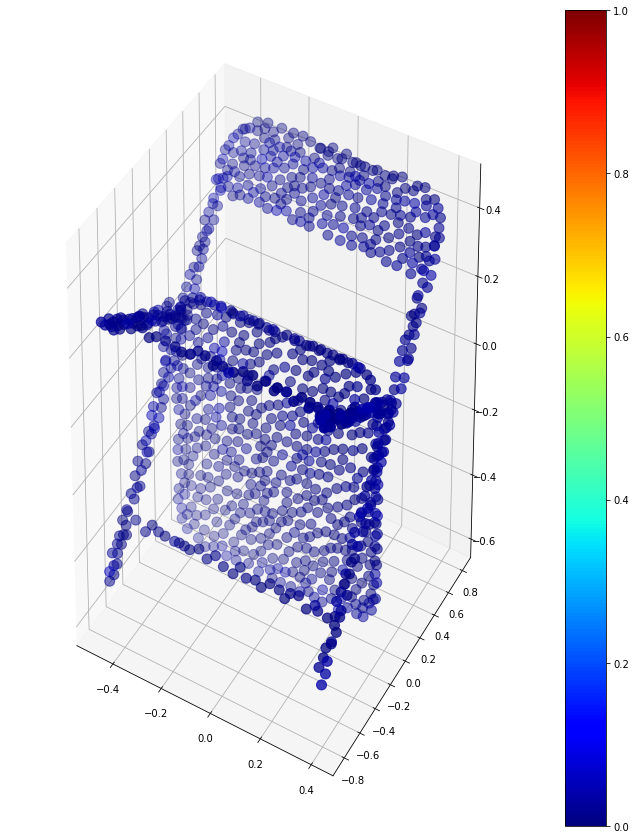

Cantidad de puntos:  1024


In [ ]:
puntosBA = plottear_DPDist_cercanos(DistBAord, pcAcOrd, 0.5)

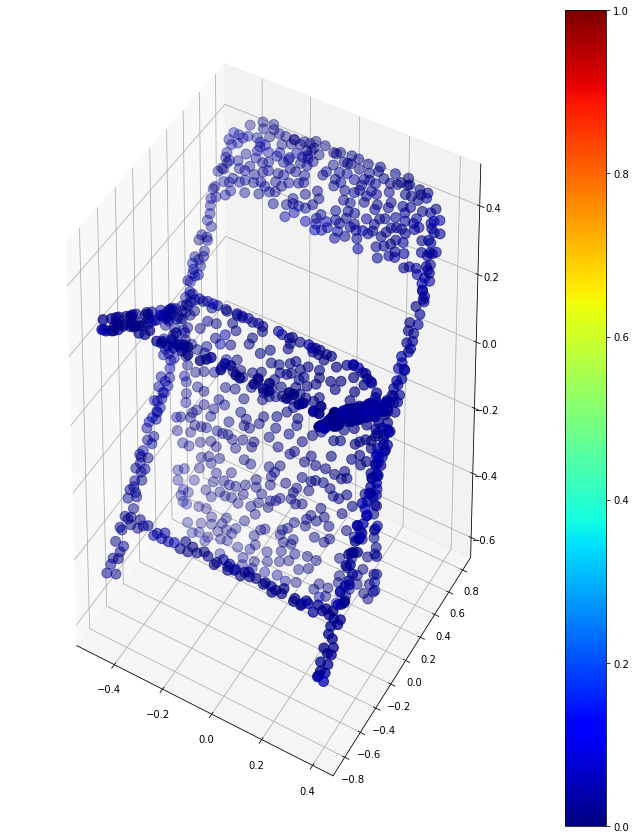

Cantidad de puntos:  1024


In [ ]:
puntosAB = plottear_DPDist_cercanos(DistABord, pcBcOrd, 0.5)

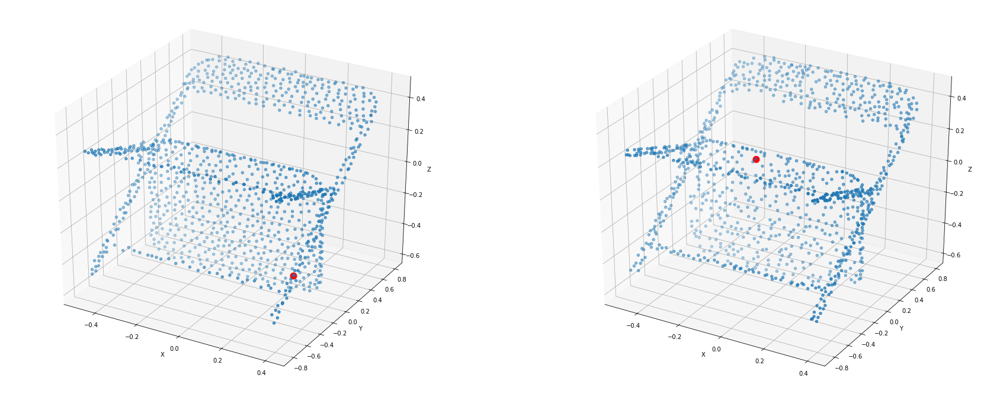

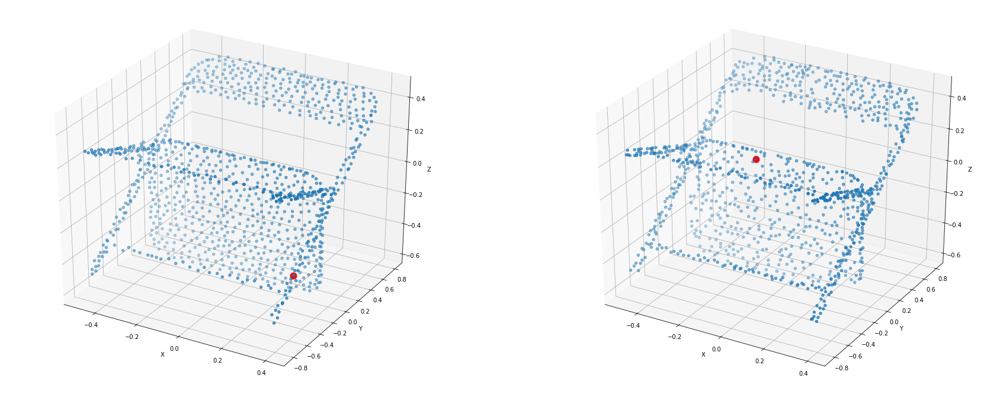

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[0,0]
Y = pcAc [0,1]
Z = pcAc[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[0,0]
Y = pcBc [0,1]
Z = pcBc[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[0,0]
Y = pcAcOrd [0,1]
Z = pcAcOrd[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[0,0]
Y = pcBcOrd [0,1]
Z = pcBcOrd[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

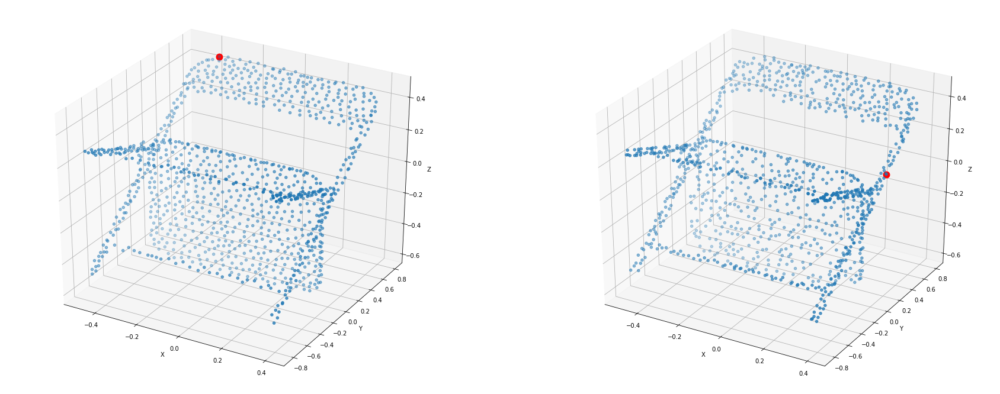

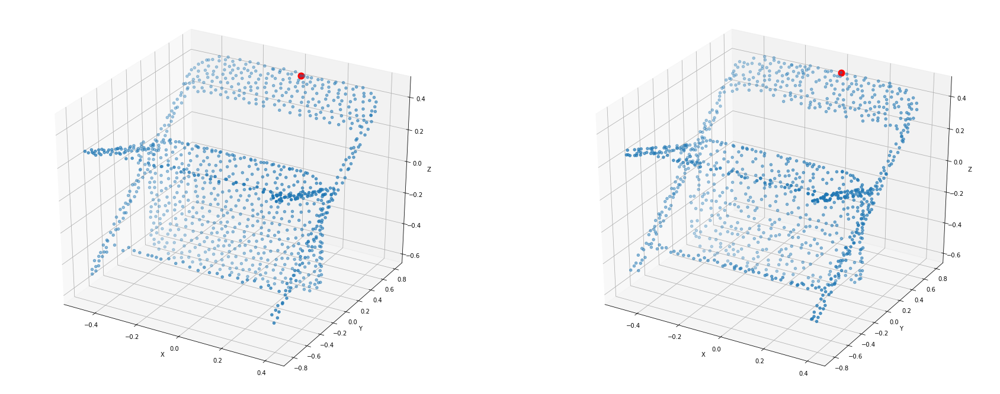

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[1,0]
Y = pcAc [1,1]
Z = pcAc[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[1,0]
Y = pcBc [1,1]
Z = pcBc[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[1,0]
Y = pcAcOrd [1,1]
Z = pcAcOrd[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[1,0]
Y = pcBcOrd [1,1]
Z = pcBcOrd[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

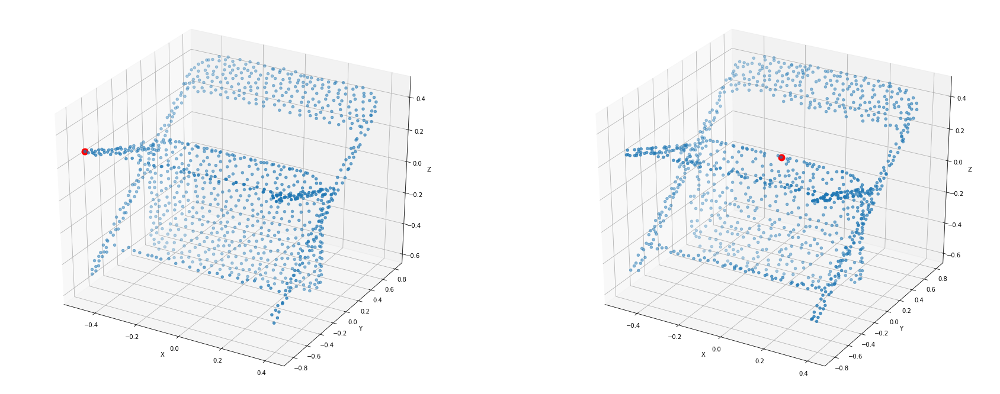

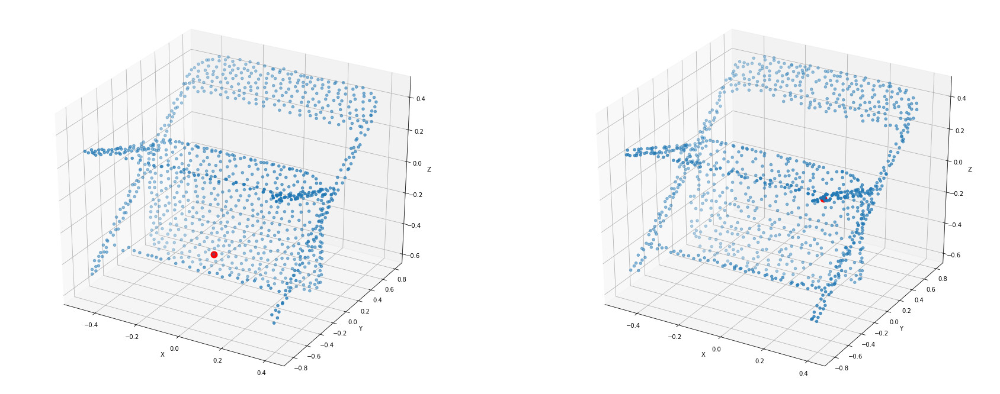

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[2,0]
Y = pcAc [2,1]
Z = pcAc[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[2,0]
Y = pcBc [2,1]
Z = pcBc[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[2,0]
Y = pcAcOrd [2,1]
Z = pcAcOrd[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[2,0]
Y = pcBcOrd [2,1]
Z = pcBcOrd[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

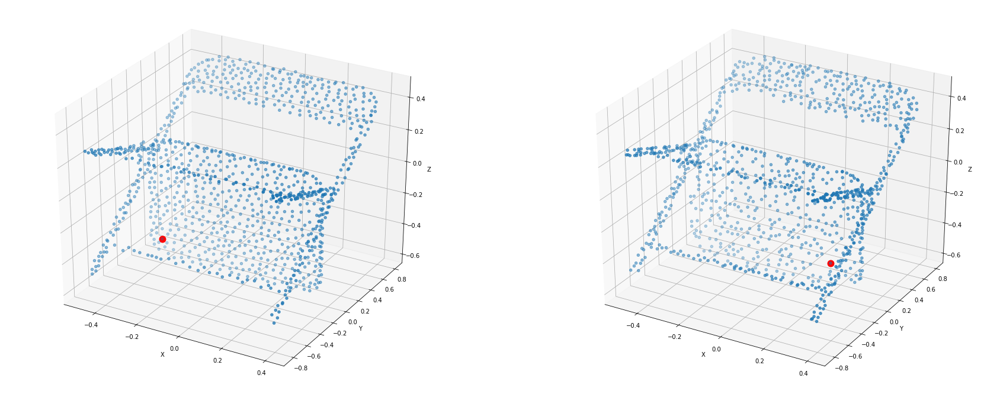

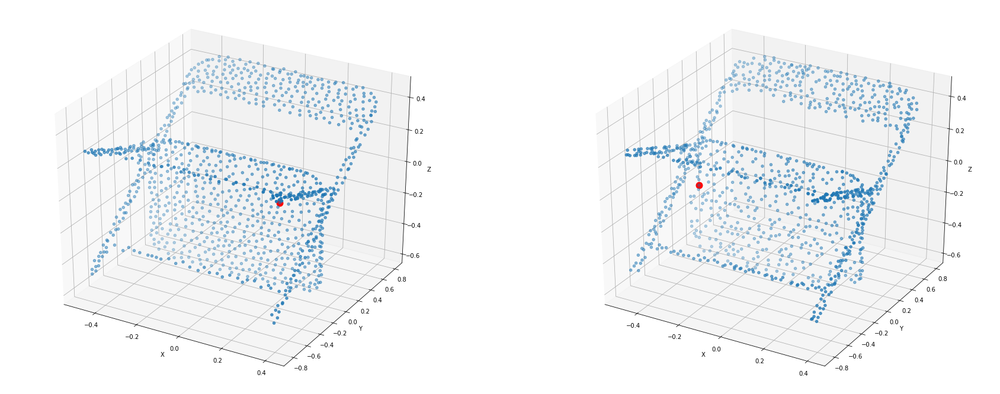

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[3,0]
Y = pcAc [3,1]
Z = pcAc[3,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[3,0]
Y = pcBc [3,1]
Z = pcBc[3,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[3,0]
Y = pcAcOrd [3,1]
Z = pcAcOrd[3,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[3,0]
Y = pcBcOrd [3,1]
Z = pcBcOrd[3,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

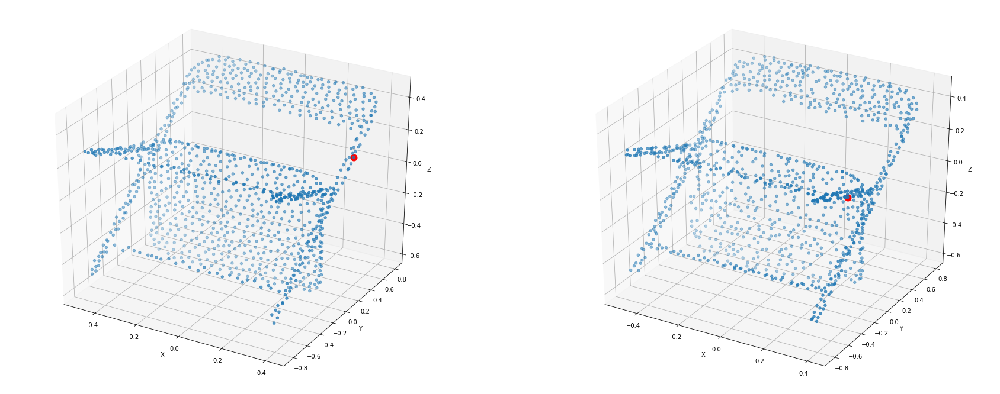

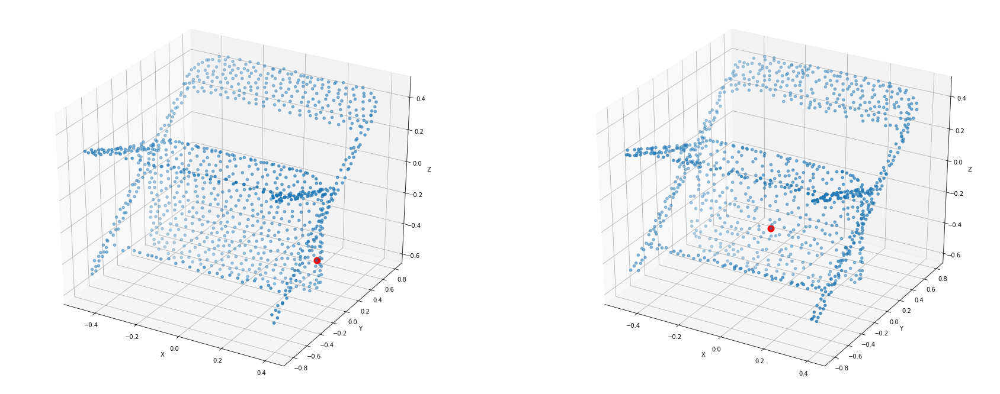

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[4,0]
Y = pcAc [4,1]
Z = pcAc[4,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[4,0]
Y = pcBc [4,1]
Z = pcBc[4,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[4,0]
Y = pcAcOrd [4,1]
Z = pcAcOrd[4,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[4,0]
Y = pcBcOrd [4,1]
Z = pcBcOrd[4,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

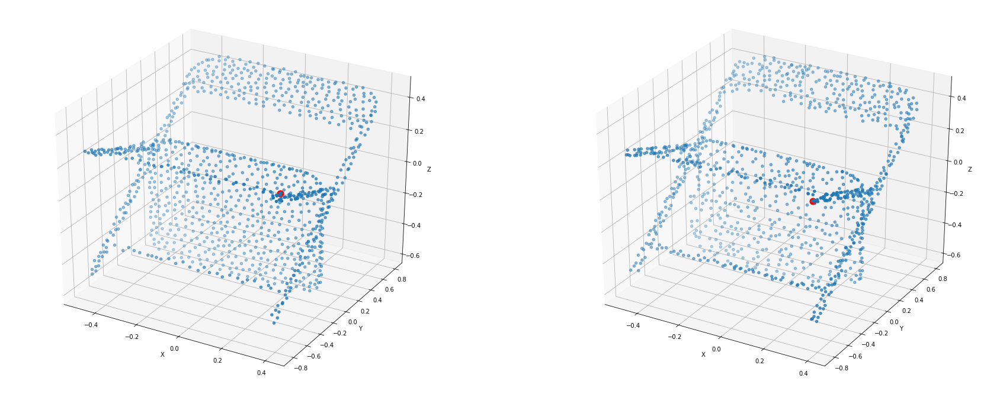

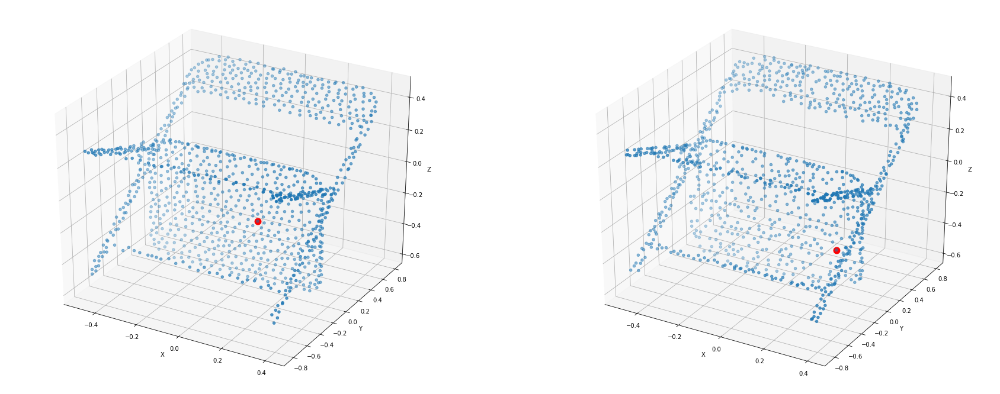

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[225,0]
Y = pcAc [225,1]
Z = pcAc[225,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[225,0]
Y = pcBc [225,1]
Z = pcBc[225,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[225,0]
Y = pcAcOrd [225,1]
Z = pcAcOrd[225,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[225,0]
Y = pcBcOrd [225,1]
Z = pcBcOrd[225,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

In [ ]:
for i in range(10):
  print(pcAcOrd[i,:], pcBcOrd[i,:])

[-0.08104918  0.71158082  0.40638082] [-0.35006374  0.51293626  0.31043626]
[-0.38321918  0.00999082  0.11888082] [-0.07517374  0.02058626 -0.50576374]
[0.38508082 0.69968082 0.37298082] [-0.41956374 -0.00538374 -0.35346374]
[-0.05848918  0.01384082 -0.34141918] [0.15793626 0.62583626 0.36233626]
[-0.17991918  0.55758082  0.32908082] [ 0.12663626  0.01969626 -0.39826374]
[0.25548082 0.01473082 0.01251082] [-0.17806374  0.01969626 -0.41626374]
[ 0.05352082  0.00190082 -0.55991918] [-0.18746374  0.02058626  0.12863626]
[-0.22091918  0.01289082  0.13948082] [-0.01677274  0.02058626 -0.09358374]
[-0.40351918  0.01473082 -0.19351918] [0.18483626 0.02058626 0.00946626]
[0.24168082 0.01384082 0.07528082] [0.38223626 0.11513626 0.05426626]


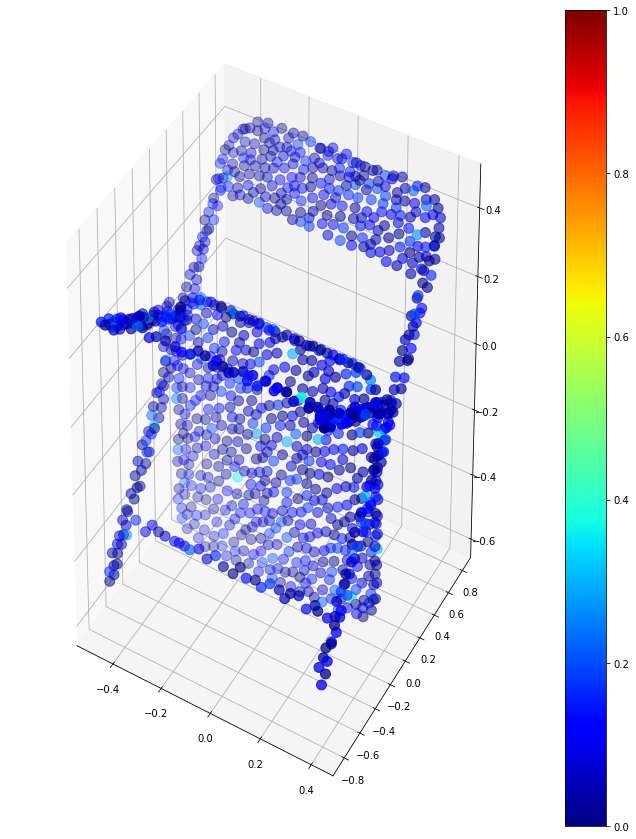

Cantidad de puntos:  1024


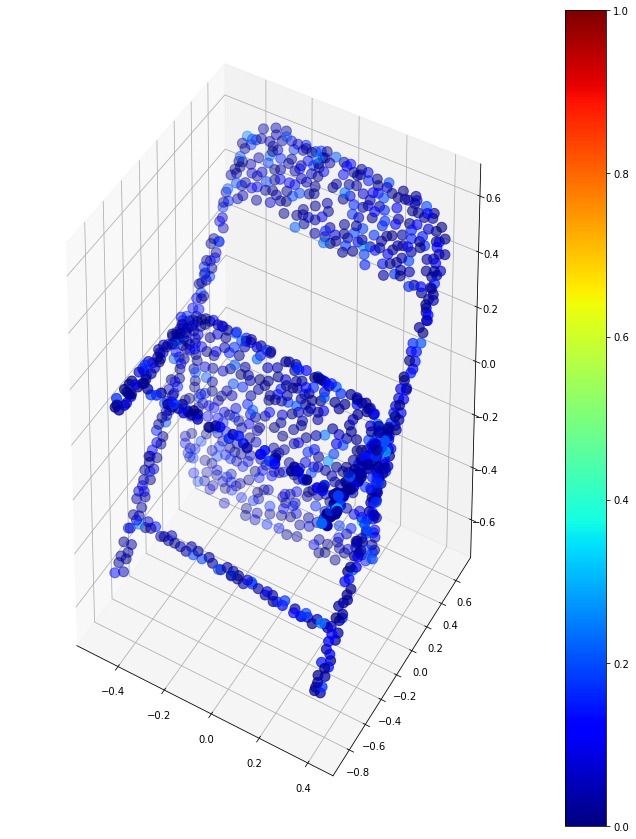

Cantidad de puntos:  1024


In [ ]:
puntosAB = plottear_DPDist_cercanos(normAB, pcAcOrd, 0.5)
puntosBA = plottear_DPDist_cercanos(normBA, pcBcOrd, 0.5)

In [ ]:
def get_vectores_distribucion(pC):
  U, S, Vt = np.linalg.svd(pC.T)
  fig = plt.figure(figsize=(30,12))

  s = np.zeros((3,3))
  np.fill_diagonal(s, S)
  U = np.dot(U,s)
  ax = fig.add_subplot(1, 2, 1, projection='3d')

  X = pC[:,0]
  Y = pC[:,1]
  Z = pC[:,2]
  ax.scatter3D(X, Y, Z, s=8)

  ax.quiver(0, 0, 0, U[0,0],U[1,0] ,U[2,0], arrow_length_ratio=0.1, color='r')
  ax.quiver(0, 0, 0, U[0,1],U[1,1] ,U[2,1], arrow_length_ratio=0.1, color='r')
  ax.quiver(0, 0, 0, U[0,2],U[1,2] ,U[2,2], arrow_length_ratio=0.1, color='r')

  #ax.quiver(0, 0, 0, np.mean(U[0,:]),U[1,:] ,U[2,:], arrow_length_ratio=0.1, color='g')
  ax.set_xlim(np.min(pC[:,0])*1.5,np.max(pC[:,0])*1.5)
  ax.set_ylim(np.min(pC[:,1])*1.5,np.max(pC[:,1])*1.5)
  ax.set_zlim(np.min(pC[:,2])*1.5,np.max(pC[:,2])*1.5)
  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_zlabel('Z')
  plt.show()
  return  np.mean(U[:,0]), np.mean(U[:,1]), np.mean(U[:,2])

In [ ]:
point_cloud_A = chair[0][0:512]
Rm = rotacionZYX(0, 0.001, 1.6) 

point_cloud_B= np.dot(Rm, chair[0][512:512*2].T).T 

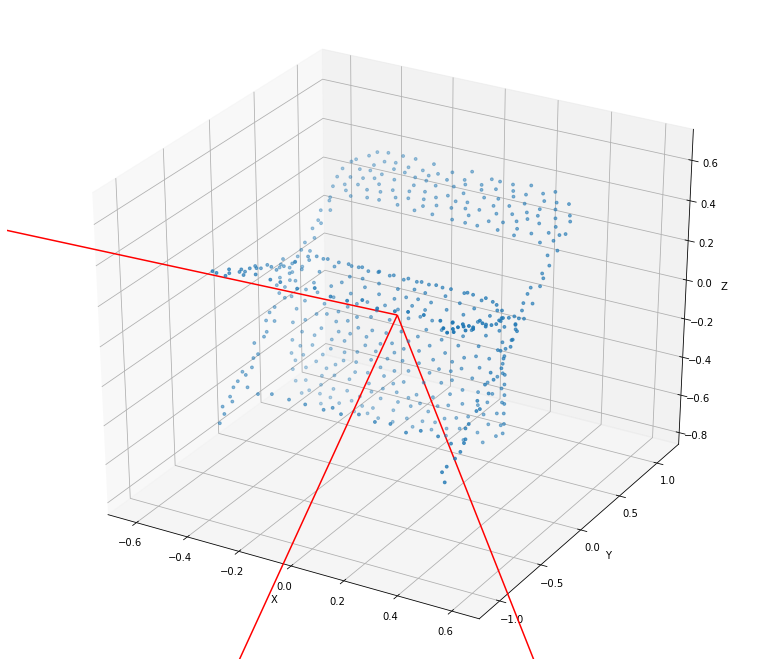

In [ ]:
x1,y1,z1 =get_vectores_distribucion(point_cloud_A)

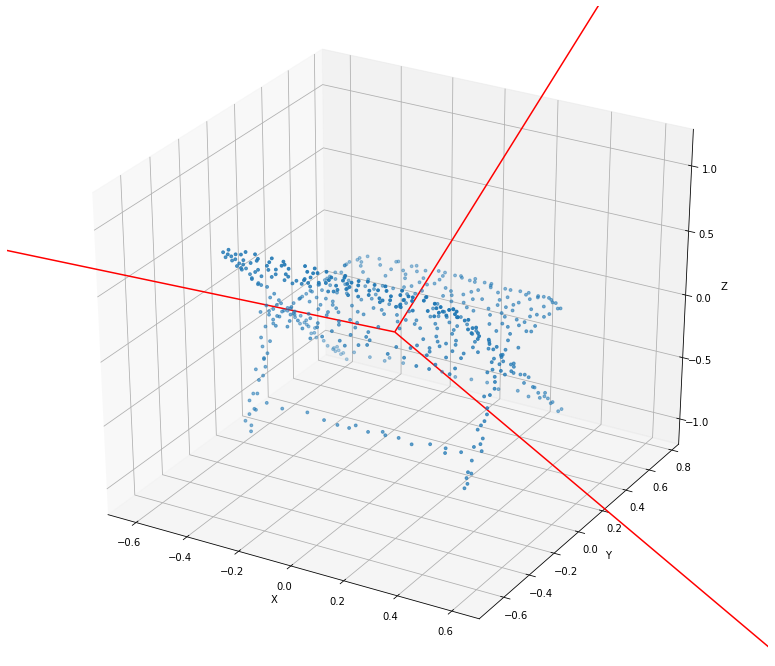

In [ ]:
x2,y2,z2 =get_vectores_distribucion(point_cloud_B)

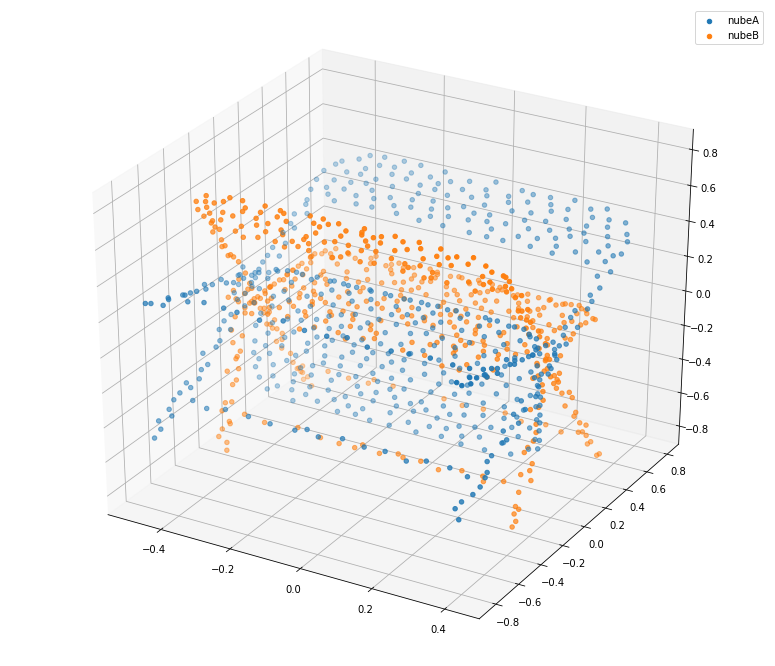

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1768: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


INFO:tensorflow:Restoring parameters from ./model.ckpt


In [ ]:
pcAc = point_cloud_A-np.mean(point_cloud_A)
pcBc = point_cloud_B-np.mean(point_cloud_B)
plottearNubes(pcAc, pcBc, 'Nubes Centradas')

vectDistAB, vectDistBA = DPDIST(pcAc, pcBc)
vectDistBA = vectDistBA.reshape(512,3)
vectDistAB =vectDistAB.reshape(512,3)  
normAB, normBA, DistPC_PC = DPDISTnormaAndDistPc_Pc(vectDistAB, vectDistBA)

In [ ]:
np.linalg.norm(np.array([x1,y1,z1]))

5.187014377911396

In [ ]:
normAB = normAB + np.linalg.norm(np.array([x1,y1,z1]))

In [ ]:
normBA = normBA + np.linalg.norm(np.array([x2,y2,z2]))

In [ ]:
vectDistBA

array([[0.2045021 , 0.        , 0.        ],
       [0.49770012, 0.        , 0.        ],
       [0.4813013 , 0.        , 0.        ],
       ...,
       [0.11956835, 0.        , 0.        ],
       [0.32689136, 0.        , 0.        ],
       [0.01443222, 0.        , 0.        ]], dtype=float32)

In [ ]:
vectDistAB

array([[0.        , 0.        , 0.        ],
       [0.15514235, 0.        , 0.        ],
       [0.01432992, 0.        , 0.        ],
       ...,
       [0.03752044, 0.        , 0.        ],
       [0.3426454 , 0.        , 0.        ],
       [0.        , 0.        , 0.        ]], dtype=float32)

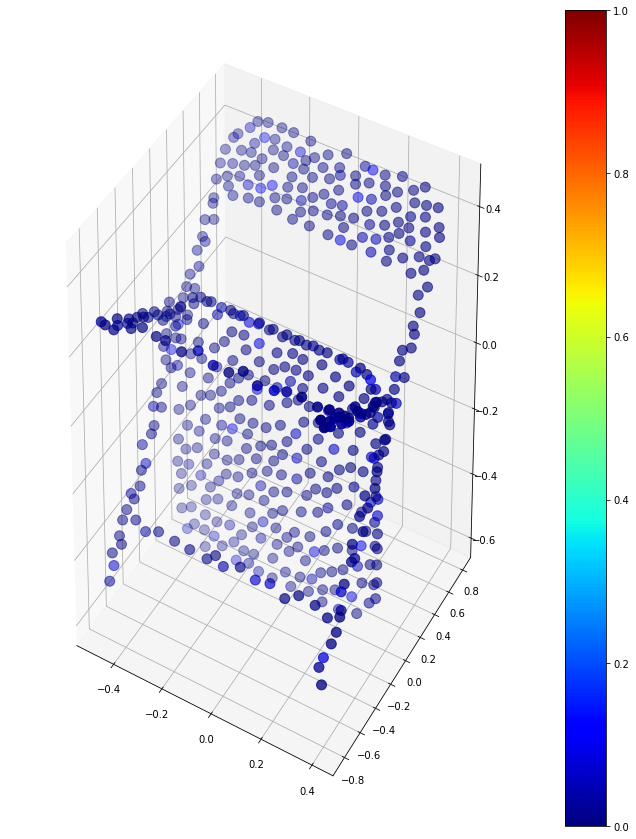

Cantidad de puntos:  512


In [ ]:
puntosAB = plottear_DPDist_cercanos(normAB, pcAc, 0.5)

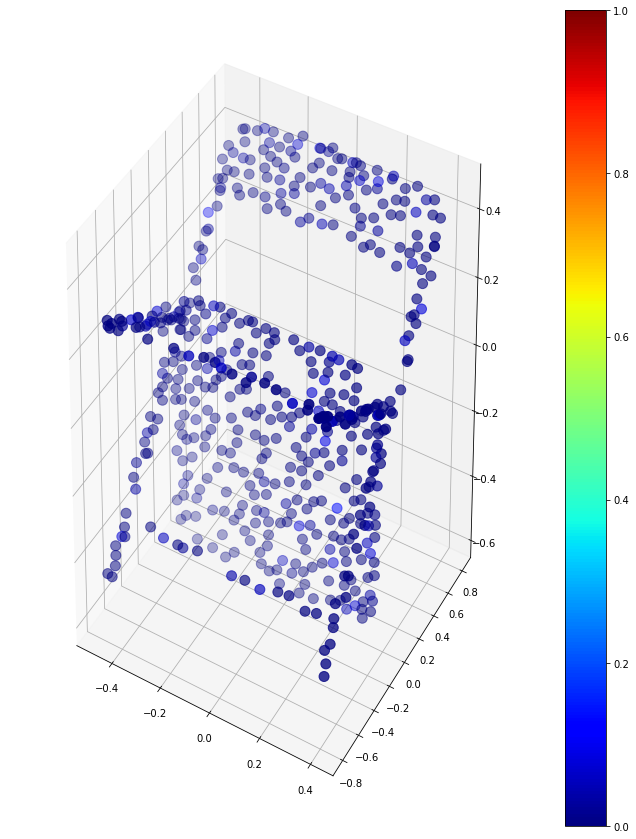

Cantidad de puntos:  512


In [ ]:
puntosAB = plottear_DPDist_cercanos(normBA, pcBc, 0.5)

In [ ]:
DistABord, pcAcOrd = ord_by_menores_distancias(normAB, pcAc)
DistBAord, pcBcOrd = ord_by_menores_distancias(normAB, pcBc)
pcAcOrd = np.array(pcAcOrd)
pcBcOrd = np.array(pcBcOrd)

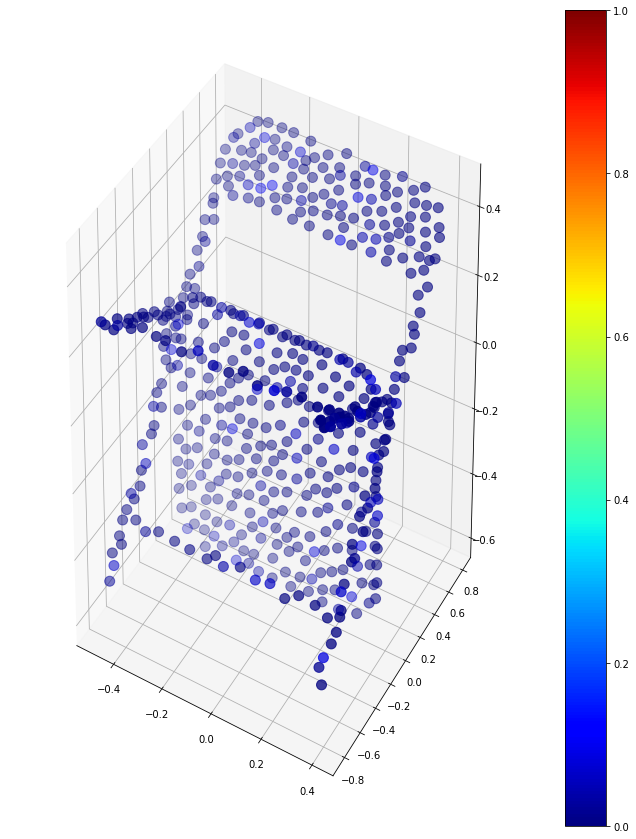

Cantidad de puntos:  512


In [ ]:
puntosBA = plottear_DPDist_cercanos(DistBAord, pcAcOrd, 0.5)

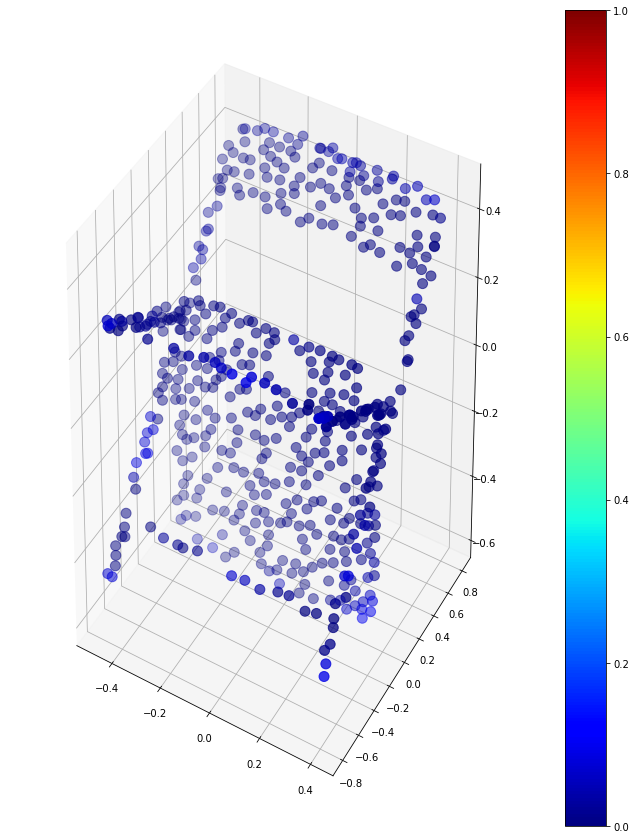

Cantidad de puntos:  512


In [ ]:
puntosAB = plottear_DPDist_cercanos(DistABord, pcBcOrd, 0.5)

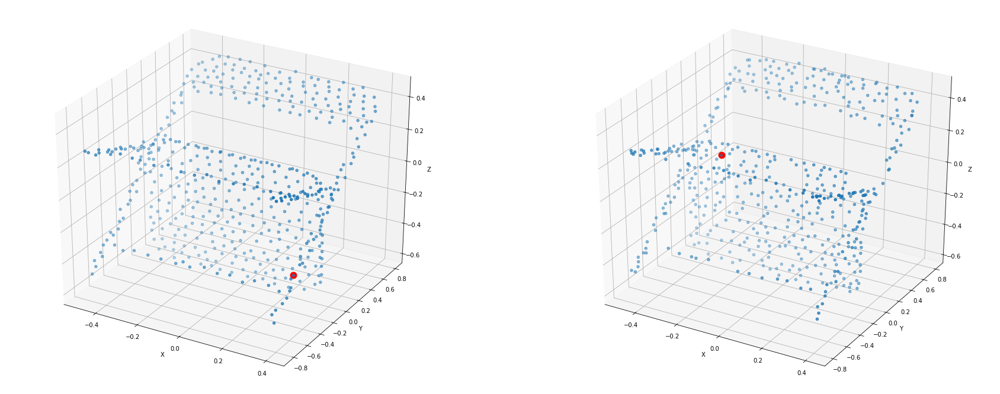

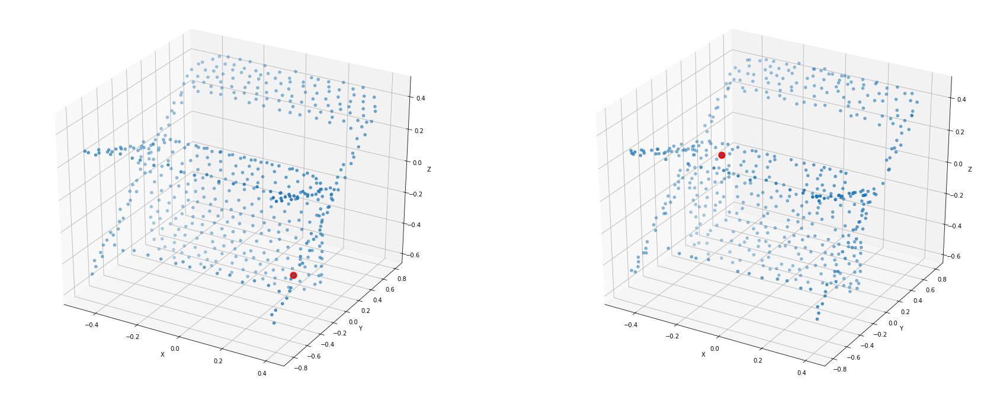

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[0,0]
Y = pcAc [0,1]
Z = pcAc[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[0,0]
Y = pcBc [0,1]
Z = pcBc[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[0,0]
Y = pcAcOrd [0,1]
Z = pcAcOrd[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[0,0]
Y = pcBcOrd [0,1]
Z = pcBcOrd[0,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

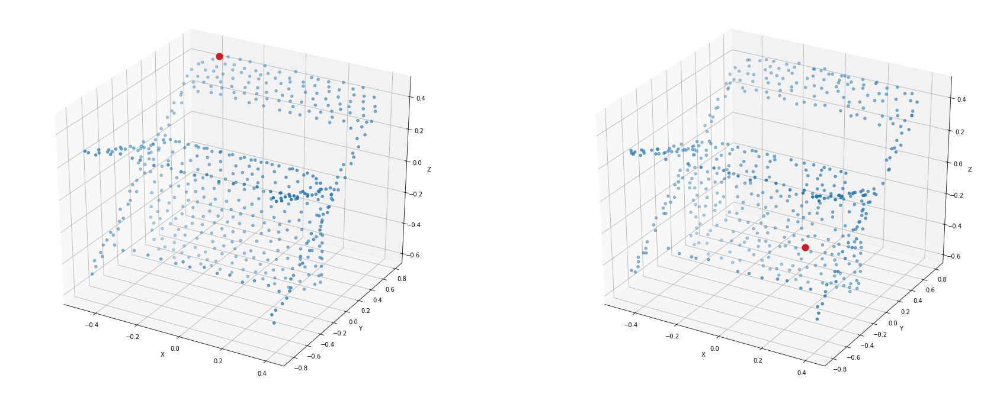

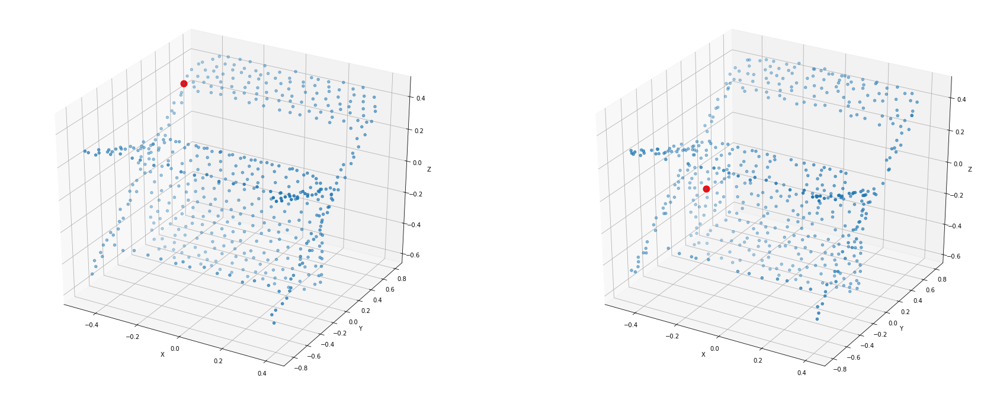

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[1,0]
Y = pcAc [1,1]
Z = pcAc[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[1,0]
Y = pcBc [1,1]
Z = pcBc[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[1,0]
Y = pcAcOrd [1,1]
Z = pcAcOrd[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[1,0]
Y = pcBcOrd [1,1]
Z = pcBcOrd[1,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

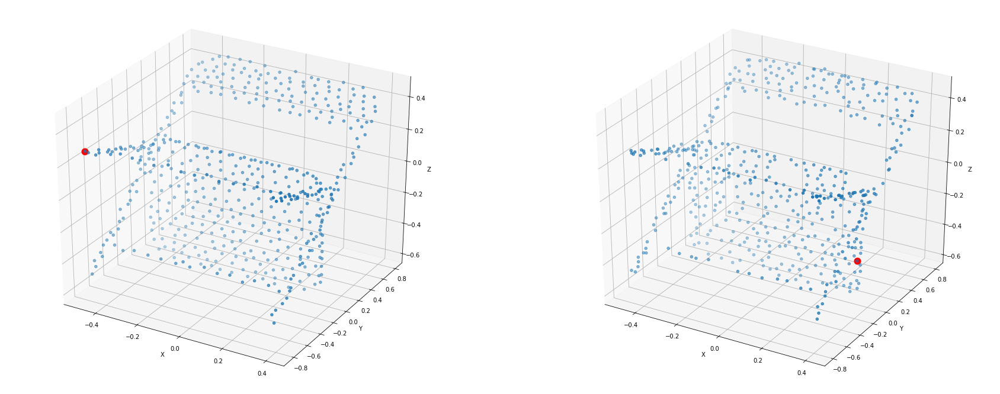

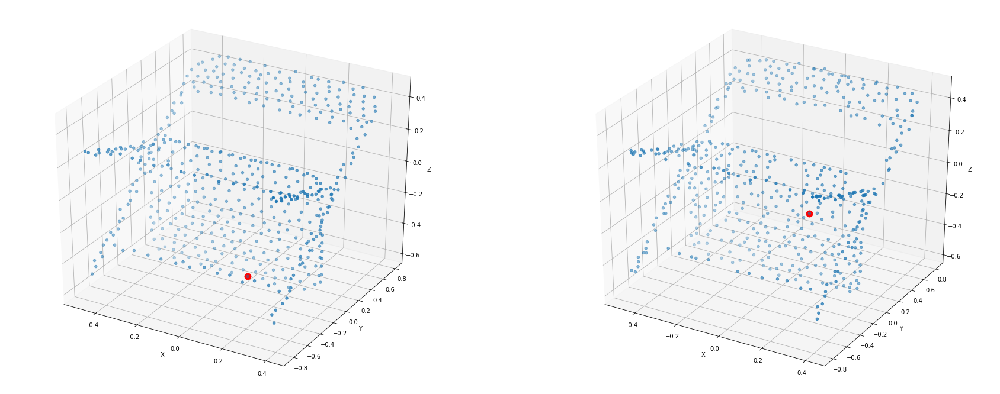

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAc[:,0]
Y = pcAc [:,1]
Z = pcAc[:,2]
ax.scatter3D(X, Y, Z)
X = pcAc[2,0]
Y = pcAc [2,1]
Z = pcAc[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBc[:,0]
Y = pcBc[:,1]
Z = pcBc[:,2]
ax.scatter3D(X, Y, Z)
X = pcBc[2,0]
Y = pcBc [2,1]
Z = pcBc[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcAcOrd[:,0]
Y = pcAcOrd [:,1]
Z = pcAcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcAcOrd[2,0]
Y = pcAcOrd [2,1]
Z = pcAcOrd[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


ax = fig.add_subplot(1, 2, 2, projection='3d')
X = pcBcOrd[:,0]
Y = pcBcOrd[:,1]
Z = pcBcOrd[:,2]
ax.scatter3D(X, Y, Z)
X = pcBcOrd[2,0]
Y = pcBcOrd [2,1]
Z = pcBcOrd[2,2]
ax.scatter3D(X, Y, Z, c='r', s=120)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()

In [ ]:
print(x,y,z)

-0.5603051170342078 -0.12124270693160623 -0.0684960960530779


In [ ]:
point_cloud_B

array([[ 0.1256    , -0.10743205,  0.05444063],
       [ 0.139     ,  0.44689397,  0.22272636],
       [ 0.1831    ,  0.01746013,  0.02209699],
       ...,
       [ 0.385     ,  0.32218695,  0.634096  ],
       [-0.01271   , -0.41554689,  0.01625932],
       [-0.02177   ,  0.42676554, -0.06460287]])

In [ ]:
pcPsvd=vectDistBA + np.array([x,y,z])

In [ ]:
pcPsvd.shape

(512, 3)

In [ ]:
pcPsvd

array([[-0.40424231,  0.30688762,  0.12140985],
       [-0.44814903,  0.30688762,  0.12140985],
       [-0.3954816 ,  0.30688762,  0.12140985],
       ...,
       [-0.44581121,  0.30688762,  0.12140985],
       [-0.47372246,  0.30688762,  0.12140985],
       [-0.47372246,  0.30688762,  0.12140985]])

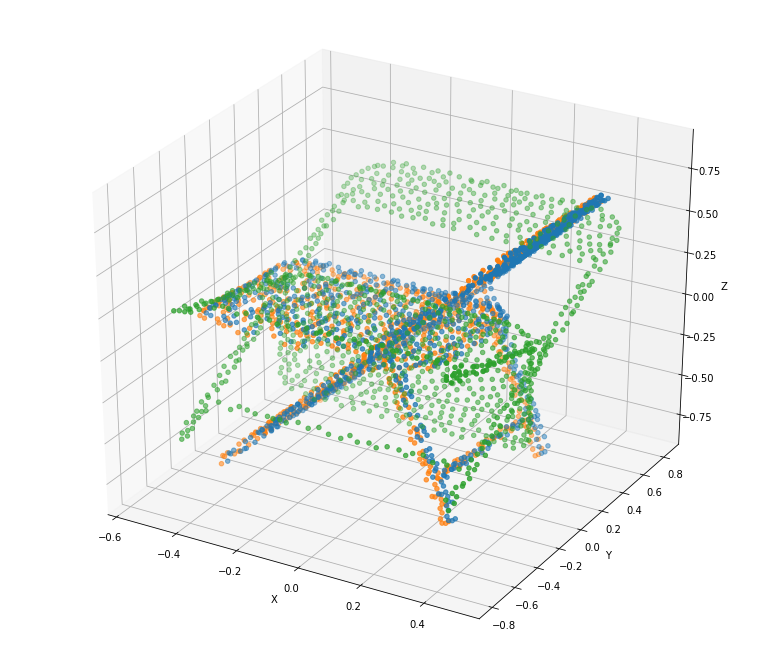

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1, projection='3d')
X = pcPsvd[:,0]
Y = pcPsvd [:,1]
Z = pcPsvd[:,2]
ax.scatter3D(X, Y, Z)
X = point_cloud_B[:,0]
Y = point_cloud_B[:,1]
Z = point_cloud_B[:,2]
ax.scatter3D(X, Y, Z)
X = point_cloud_A[:,0]
Y = point_cloud_A[:,1]
Z = point_cloud_A[:,2]
ax.scatter3D(X, Y, Z)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')



plt.show()


In [ ]:
point_cloud_B= np.dot(Rm, chair[0][1024*2:1024*3].T).T 

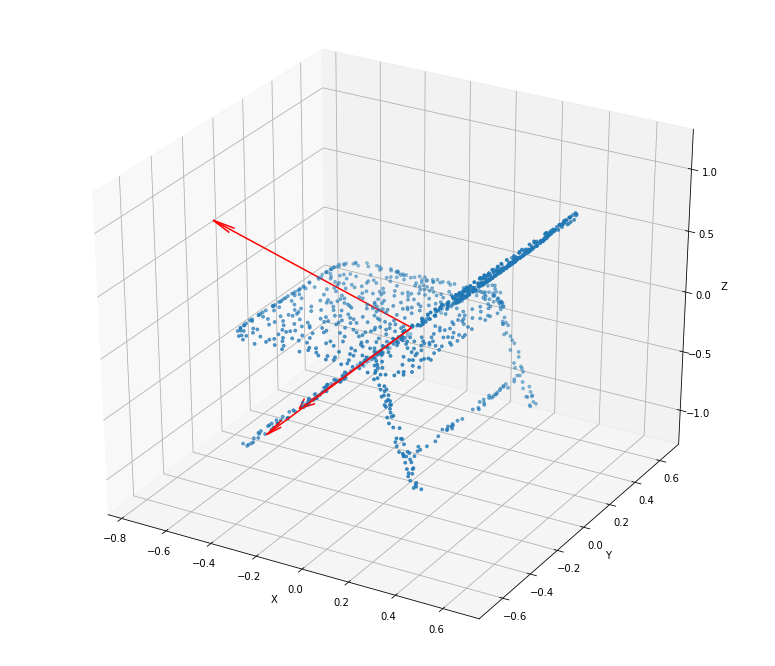

(0.46399681465317166, 0.31751713983464297, 0.13123701930580234)

In [ ]:
get_vectores_distribucion(point_cloud_B)